# February 3rd, 2020 (Wednesday) Data Analysis Notebook

In [1]:
# current date, for retrieving data from proper location.
year = "2021"
month = "February"
day = "3"

## Imports and initialization

In [26]:
import numpy as np 
from numpy import array as arr
import pandas as pd
import plotly.offline as pltly
pltly.init_notebook_mode(connected=True)
from plotly import graph_objs as go
import math
import scipy.optimize as opt
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import warnings 
warnings.filterwarnings('module')
from datetime import datetime
import uncertainties.unumpy
import IPython
import pandas as pd
import pickle

from matplotlib.pyplot import *
from matplotlib import rcParams
from matplotlib import style
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
%matplotlib inline

# ## set matplotlib plot defaults :D
# Style controls many default colors in matplotlib plots.
# Change the following if you don't like dark backgrounds. Many other options.
import matplotlib as mpl

if False:
    # My Dark Settings
    style.use(['dark_background'])
    c = '#0A0A0A'
    mpl.rcParams['axes.facecolor'] = '#000000'
    mpl.rcParams['figure.edgecolor'] = c
    mpl.rcParams['figure.facecolor'] = c
else:
    # My Light Settings
    style.use(['default'])
    c = '#FFFFFF'
    mpl.rcParams['axes.facecolor'] = c
    mpl.rcParams['figure.edgecolor'] = c
    mpl.rcParams['figure.facecolor'] = c  
# the default cycling of colors in this mode isn't very good.
#rcParams['axes.prop_cycle'] = ("cycler('color', ['r','c','g','#FFFFFF','b']) + cycler('marker', ['o','v','<','>','^'])")
### General
rcParams['figure.figsize'] = (25.0, 8.0)
rcParams['axes.grid'] = True
rcParams['axes.formatter.useoffset'] = False
rcParams['grid.alpha'] = 0.15
rcParams['axes.formatter.limits'] = (-3,3)
rcParams['image.cmap'] = 'viridis'
#rcParams['image.cmap'] = dark_viridis_cmap
# to see all available options, decomment this line.
# print(mpl.rcParams)
rcParams['font.size'] = 14
from matplotlib import cm
viridis = cm.get_cmap('viridis', 256)
dark_viridis = []
bl = 0.15
for i in range(256):
    dark_viridis.append(list(viridis(i)))
    dark_viridis[-1][0] = dark_viridis[-1][0] *(bl+(1-bl)*i/255)
    dark_viridis[-1][1] = dark_viridis[-1][1] *(bl+(1-bl)*i/255)
    dark_viridis[-1][2] = dark_viridis[-1][2] *(bl+(1-bl)*i/255)
dark_viridis_cmap = ListedColormap(dark_viridis)

In [27]:
from Analysis_Python_Files.fitters.Gaussian import dip, double_dip, bump, bump2, bump3, bump2r, gaussian, bump3_Sym
from Analysis_Python_Files.fitters.Sinc_Squared import sinc_sq3_Sym, sinc_sq
from Analysis_Python_Files.fitters import decaying_cos, exponential_decay_fixed_limit as decay, linear, LargeBeamMotExpansion
import Analysis_Python_Files.PictureWindow as pw
import Analysis_Python_Files.ExpFile as exp
exp.setPath(day, month, year)
import Analysis_Python_Files.PlotlyPlotters as pp
import Analysis_Python_Files.MatplotlibPlotters as mp
import Analysis_Python_Files.MainAnalysis as ma
import Analysis_Python_Files.AnalysisHelpers as ah
import Analysis_Python_Files.Miscellaneous as misc
import Analysis_Python_Files.PopulationAnalysis as pa
import Analysis_Python_Files.MarksConstants as mc
import Analysis_Python_Files.fitters as fitters
import Analysis_Python_Files.LoadingFunctions as lf
import Analysis_Python_Files.FreeSpaceImaging as fsi
import Analysis_Python_Files.TransferAnalysis as ta
import Analysis_Python_Files.LightShiftCalculations as lsc
import Analysis_Python_Files.CalibrationAnalysis as ca
from Analysis_Python_Files.TransferAnalysisOptions import TransferAnalysisOptions as ao
import Analysis_Python_Files.ThresholdOptions as to
import Analysis_Python_Files.TransferAnalysisOptions as tao

import imp
def reloadAll(day_=None, diplsayErrors=False):
    for module in sys.modules.values():
        try:
            reload(module)
        except NotImplementedError:
            if diplsayErrors:
                print(module, 'NotImplementedError')
        except AttributeError:
            if diplsayErrors:
                print(module, 'AttributeError')
        except TypeError:
            if diplsayErrors:
                print(module, 'ValueError')
        except ImportError:
            if diplsayErrors:
                print(module, 'ImportError')
    if day_ is None:
        day_ = day
    setPath(day_,month,year)

In [28]:
from importlib import reload
def reloadMyModules(day_=None, month_=None, year_=None):
    reload(exp)
    if day_ is None:
        day_ = day
    if month_ is None:
        month_ = month
    if year_ is None:
        year_ = year
    setPath(day_,month_,year_)
    reload(lf)
    reload(misc)
    reload(ma)
    reload(ah)
    reload(pp)
    reload(mp)
    reload(fitters)
    reload(fsi)
    reload(ta)
    reload(pa)
    reload(tao)
    reload(ca)
reloadMyModules()

## Standard Calibrations

### Temperature

#### Running Temperature

In [5]:
reloadMyModules()


 2020
January, February, March, April, May, June, July, August, September, October, November, December, 
 2021
January, February, March, April, May, June, July, August, September, October, November, December, 

(20.0, 30.0)

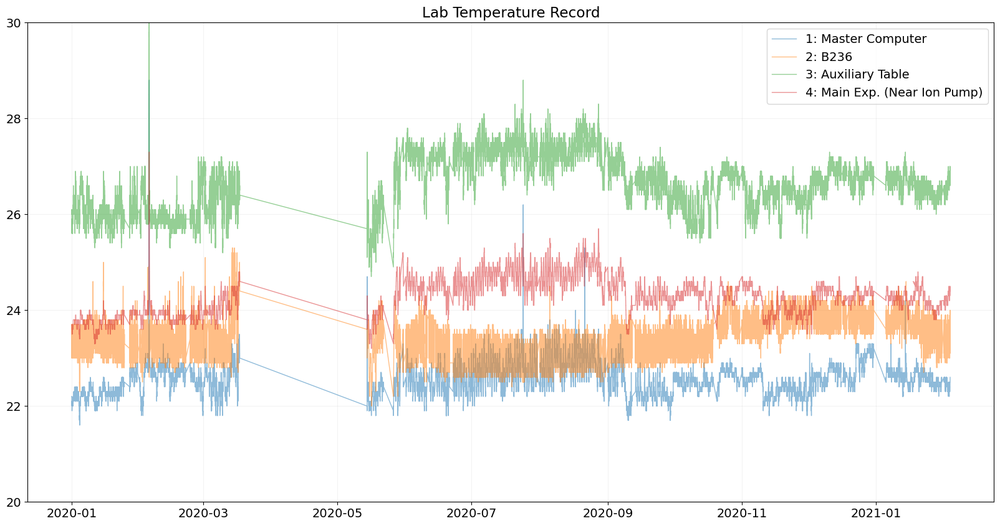

In [6]:
cTemps, cTimes = ca.loadAllTemperatureData()
legends = ['1: Master Computer', '2: B236', '3: Auxiliary Table', '4: Main Exp. (Near Ion Pump)']
fig, ax = plt.subplots(figsize=(20,10))
for temp,lab in zip(misc.transpose(cTemps), legends):
    ax.plot(cTimes,temp, label=lab, alpha=0.5, linewidth=1)
ax.legend()
ax.set_title('Lab Temperature Record');
ax.set_ylim(20,30)

#### Today's Temperature

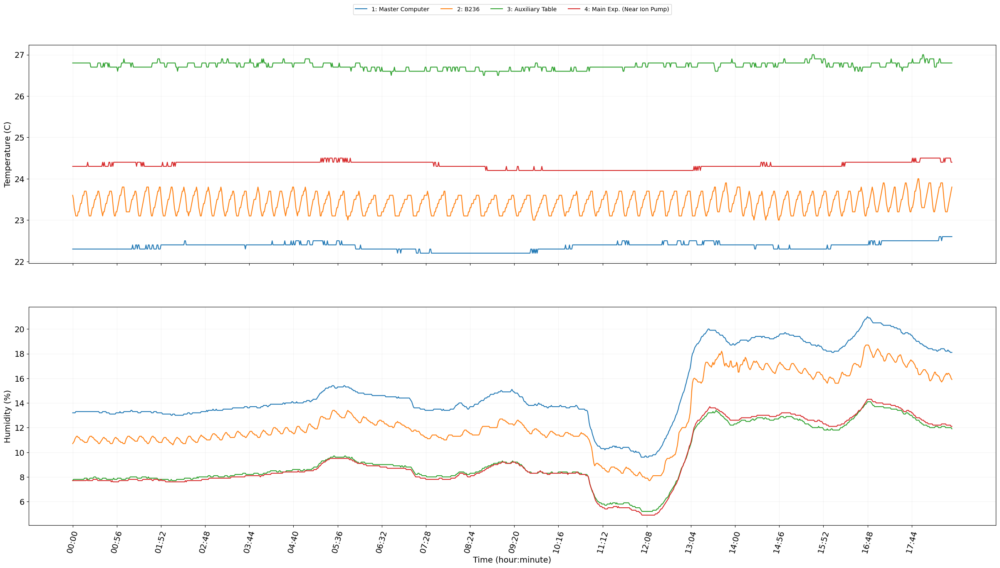

In [7]:
reloadMyModules()
ah.Temperature();

## individual calibrations

In [4]:
ea = None
sCalData = {"Loading":ea,"ImagingSurvival":ea,"MOT_Size":ea,"MOT_FillTime":ea, "MOT_Temperature":ea,
           "RPGC_Temperature":ea,"LGM_Temperature":ea,"ThermalTrapFreq":ea, "ThermalNbar":ea, 
           "AxialTrapFreq":ea, "AxialCarrierLocation":ea, "AxialNbar":ea, "RadialTrapFreq":ea,
           "RadialNbar":ea, "RadialCarrierLocation":ea, "DeepScatteringResonance":ea, "DeepDepth":ea, 
           "ShallowScatteringResonance":ea, "ShallowDepth":ea, "ResonanceDelta":ea, "SpotSize2Freqs":ea, 
           "SpotSizeRadialDepth":ea, "SpotSizeAxDepth":ea, "RamanDepth":ea, "ResonanceDepthDelta":ea, "Lifetime":ea }

### File BASIC_SINGLE_ATOMS (7x1_Atom_Loading_And_Imaging)

Number of Pictures: 2000; Picture Dimensions: 5 x 23
Variations: 1;	Repetitions: 1000;	Exp File Version: 4;
Experiment started at (H:M:S) 4:56:58: on (Y-M-D) 2021-2-3, And ended at 5:4:49: on 2021-2-3
Experiment Notes: HDF5 NOT ANNOTATED: please call exp.Annotate() to annotate this file.



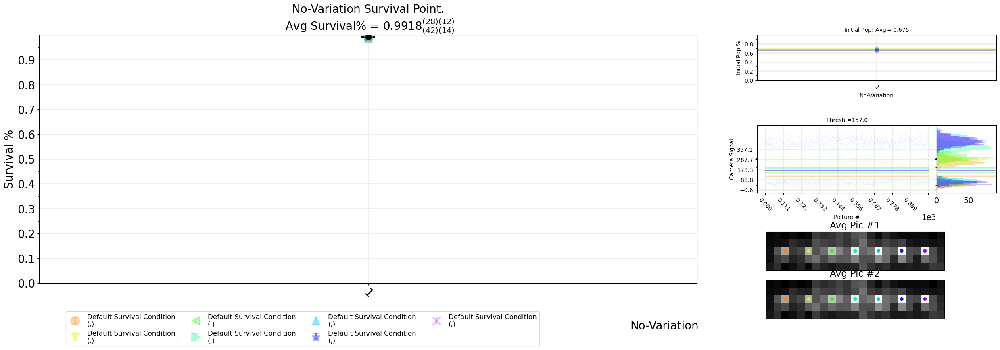

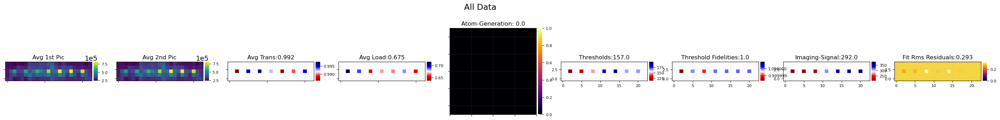

In [8]:
res = mp.Survival("BASIC_SINGLE_ATOMS", [2,2,3,7,1], forceNoAnnotation=True);
dt = exp.getStartDatetime("BASIC_SINGLE_ATOMS")
avgVals = [np.mean(vals) for vals in misc.transpose(res['Initial_Populations'])]
sCalData['Loading'] = ca.calPoint(np.max(avgVals), np.std(misc.transpose(res['Initial_Populations'])[np.argmax(avgVals)]),dt)
sCalData['ImagingSurvival'] = ca.calPoint(res['Average_Transfer'][0],res['Average_Transfer_Err'][0],dt)

### MOT_NUMBER

integrated saturated counts subtracting background = 4680.3197116161755
loading time 1/e = 2.076164558253615 s
Light Scattered off of full MOT: 169.75553545135574 nW


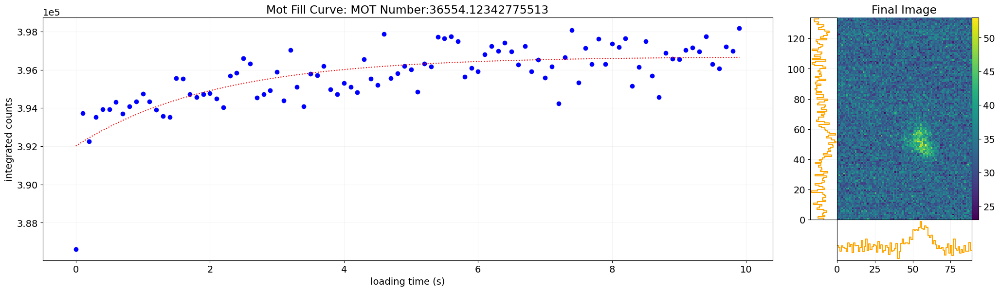

In [9]:
with exp.ExpFile() as file:
    file.open_hdf5('MOT_NUMBER')
    exposureTime = file.f['Basler']['Exposure-Time'][0]*20*1e-6
res = mp.plotMotNumberAnalysis('MOT_NUMBER', motKey=np.arange(0,10,0.1), exposureTime=exposureTime);
dt = exp.getStartDatetime("MOT_NUMBER")
sCalData['MOT_Size'] = ca.calPoint(res[0], 0, dt)
sCalData['MOT_FillTime'] = ca.calPoint(res[1], res[3], dt)

### MOT_TEMPERATURE

C:\Users\Regal-Lab\Code\Data-Analysis-Code\Analysis_Python_Files\AnalysisHelpers.py:514: UserWarning:

Vertical Average Picture Fitting Failed!

C:\Users\Regal-Lab\Code\Data-Analysis-Code\Analysis_Python_Files\AnalysisHelpers.py:527: UserWarning:

Horizontal Average Picture Fitting Failed!




Temperture in the Large Laser Beam Approximation (2D Fits): 50(28) uK

Temperture in the Large Laser Beam Approximation (1D Fits): 28(14) uK
2D Fit-Parameters: [2.52154775e-03 3.48180362e-08 5.00221005e-05]


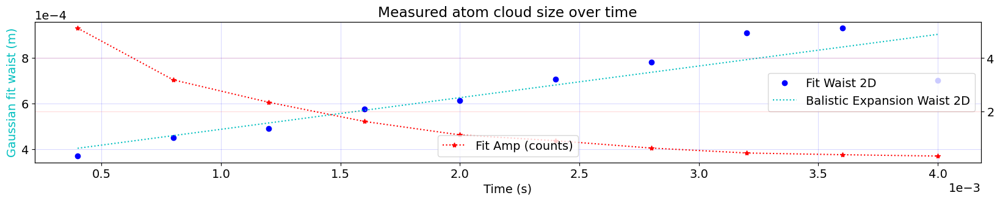

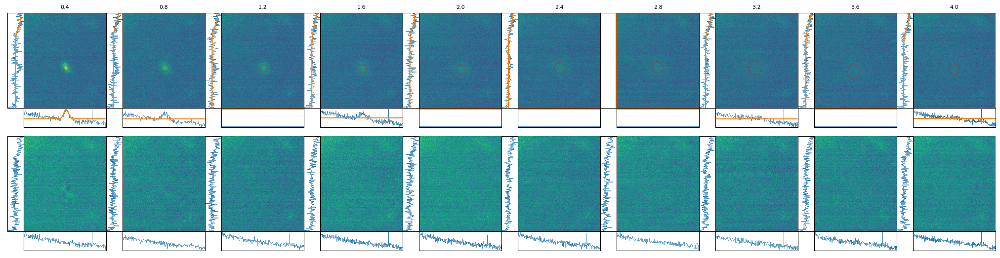

In [10]:
res = mp.plotMotTemperature('MOT_TEMPERATURE', reps=15, fitWidthGuess=15);
dt = exp.getStartDatetime("MOT_TEMPERATURE")
sCalData['MOT_Temperature'] = ca.calPoint(res[-2],res[-1],dt) 

### RED_PGC_TEMPERATURE

C:\Users\Regal-Lab\Code\Data-Analysis-Code\Analysis_Python_Files\AnalysisHelpers.py:527: UserWarning:

Horizontal Average Picture Fitting Failed!

C:\Users\Regal-Lab\Code\Data-Analysis-Code\Analysis_Python_Files\AnalysisHelpers.py:937: UserWarning:

Mot Temperature Expansion Fit Failed!




Temperture in the Large Laser Beam Approximation (2D Fits): 37(11) uK

Temperture in the Large Laser Beam Approximation (1D Fits): 0.00(0) uK
2D Fit-Parameters: [-5.24877272e-04  1.86269342e-04  3.71979024e-05]


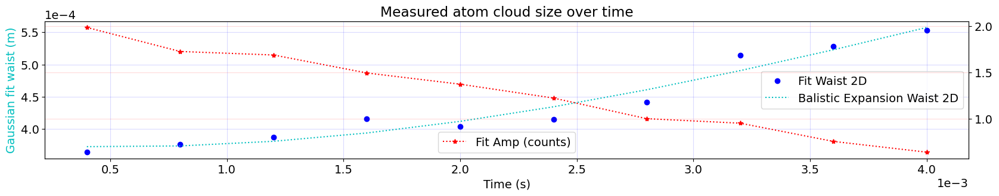

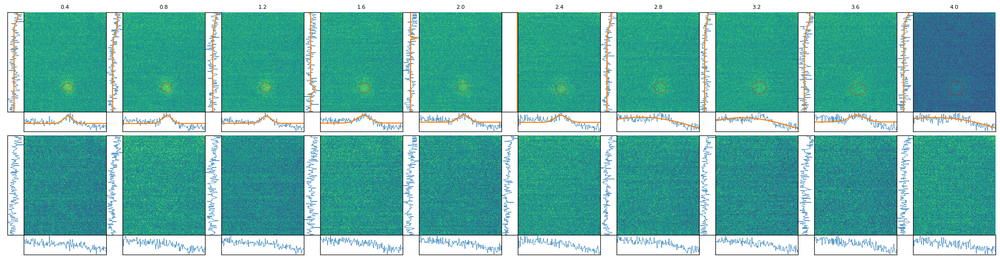

In [11]:
res = mp.plotMotTemperature('RED_PGC_TEMPERATURE', reps=15, fitWidthGuess=3, window=pw.PictureWindow(xmin=30, xmax=175, ymin=65, ymax=240));
dt = exp.getStartDatetime("RED_PGC_TEMPERATURE")
sCalData['RPGC_Temperature'] = ca.calPoint(res[-2], res[-1], dt)

### GREY_MOLASSES_TEMPERATURE

lastdataisbackground: (150, 391, 341)


C:\Users\Regal-Lab\Code\Data-Analysis-Code\Analysis_Python_Files\AnalysisHelpers.py:527: UserWarning:

Horizontal Average Picture Fitting Failed!

C:\Users\Regal-Lab\Code\Data-Analysis-Code\Analysis_Python_Files\AnalysisHelpers.py:514: UserWarning:

Vertical Average Picture Fitting Failed!

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:829: OptimizeWarning:

Covariance of the parameters could not be estimated




Temperture in the Large Laser Beam Approximation (2D Fits): 3.88(0) uK

Temperture in the Large Laser Beam Approximation (1D Fits): 0(6300) uK
2D Fit-Parameters: [ 1.32614556e-02 -4.10150439e-09  3.88275535e-06]


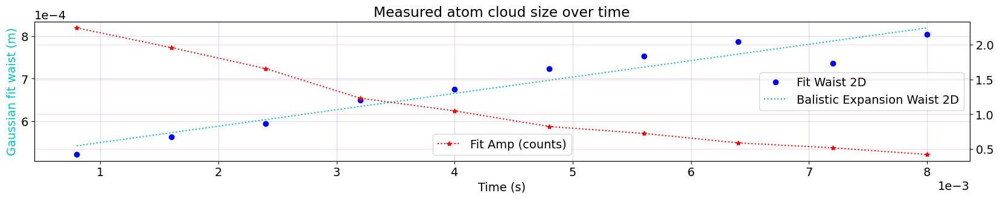

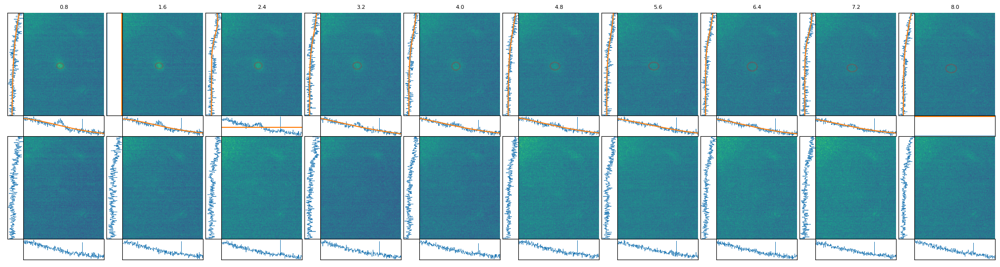

In [12]:
res = mp.plotMotTemperature('GREY_MOLASSES_TEMPERATURE', reps=15, fitWidthGuess=20, lastDataIsBackground=True, window=pw.PictureWindow(xmin=35));
dt = exp.getStartDatetime("GREY_MOLASSES_TEMPERATURE")
sCalData['LGM_Temperature'] = ca.calPoint(res[-2], res[-1], dt) 

### File 3DSBC_TOP_CARRIER_RAMAN_SPECTROSCOPY (3DGSBC_Carrier_Calibration)

Number of Pictures: 2500; Picture Dimensions: 5 x 23
Variations: 10;	Repetitions: 125;	Exp File Version: 4;
Experiment started at (H:M:S) 5:34:17: on (Y-M-D) 2021-2-3, And ended at 5:45:41: on 2021-2-3
Experiment Notes: HDF5 NOT ANNOTATED: please call exp.Annotate() to annotate this file.

[5.08219720e-02 9.83577460e-07 1.24507619e-06 3.10726521e-02]
Avg Fit R-Squared: 0.973


Amp: 0.740(51)<br>  Center: 6.83093433(98)<br>  $\sigma$: 0.0000142(12)<br>  offset: 0.029(31)<br>  Fit-Center: 6.83093433(98)

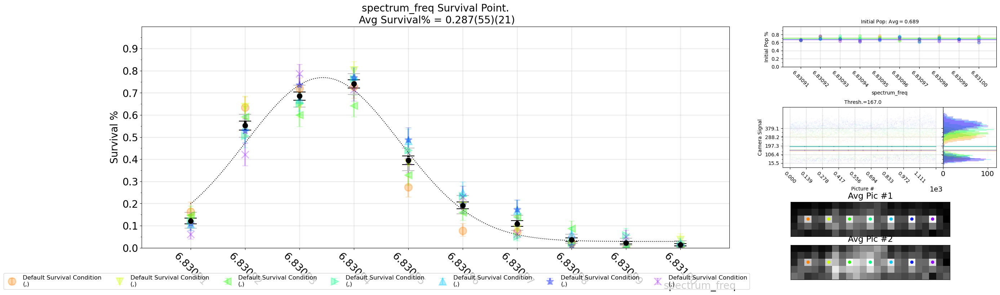

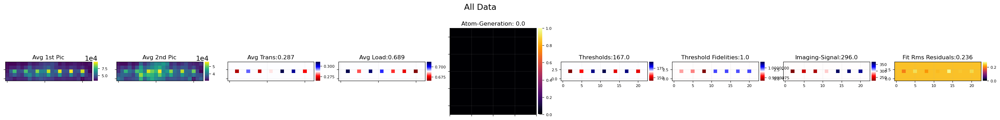

In [13]:
res = mp.Survival( "3DSBC_TOP_CARRIER_RAMAN_SPECTROSCOPY", [2,2,3,7,1], fitModules=[bump], forceNoAnnotation=True);
dt = exp.getStartDatetime("3DSBC_TOP_CARRIER_RAMAN_SPECTROSCOPY")
fit = res['Average_Transfer_Fit']
sCalData['RadialCarrierLocation'] = ca.calPoint(fit['vals'][1], fit['errs'][1], dt) 

### File THERMAL_TOP_SIDEBAND_RAMAN_SPECTROSCOPY (GPulse_Thermal_Top_Sideband_Raman_Spectroscopy)

Number of Pictures: 3000; Picture Dimensions: 5 x 23
Variations: 30;	Repetitions: 50;	Exp File Version: 4;
Experiment started at (H:M:S) 5:20:0: on (Y-M-D) 2021-2-3, And ended at 5:34:16: on 2021-2-3
Experiment Notes: HDF5 NOT ANNOTATED: please call exp.Annotate() to annotate this file.

[ 0.02768098  0.08779722  2.78039355  2.98995417  0.26551808 23.36919067
 21.08482703]
Avg Fit R-Squared: 0.548


Offset: 0.169(28)<br>  $A_1$: 0.411(88)<br>  $x_1$: -140.8(28)<br>  $\sigma_1$: 11.6(30)<br>  $A_2$: 0.05(27)<br>  $x_2$: 149(23)<br>  $\sigma_2$: 3(21)<br>  $\bar{n}$: 0.13(82)

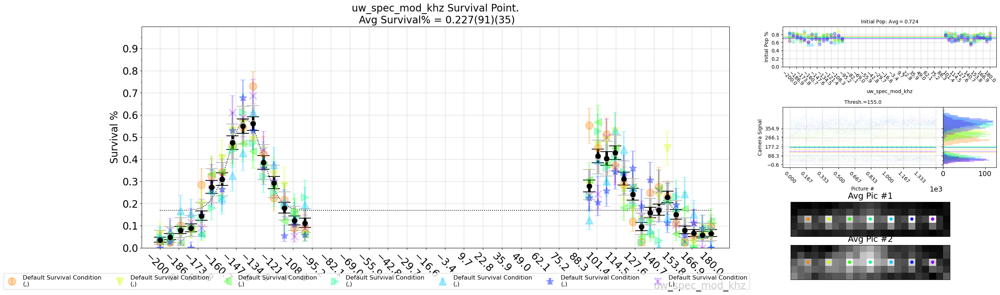

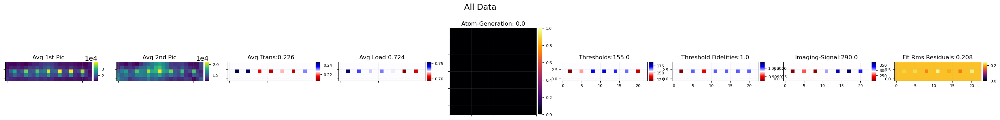

In [14]:
res = mp.Survival( "THERMAL_TOP_SIDEBAND_RAMAN_SPECTROSCOPY", [2,2,3,7,1], 
                   forceNoAnnotation=True, fitModules=[bump2], 
                   fitguess=[[0,0.3,-150,10, 0.3, 150, 10]]);
dt = exp.getStartDatetime("THERMAL_TOP_SIDEBAND_RAMAN_SPECTROSCOPY")
fit = res['Average_Transfer_Fit']
sCalData['ThermalTrapFreq'] = ca.calPoint((fit['vals'][-2] - fit['vals'][2]) / 2, np.sqrt(fit['errs'][-2]**2/4+fit['errs'][2]**2/4), dt) 
sCalData['ThermalNbar'] = ca.calPoint(bump2.fitCharacter(fit['vals']), bump2.fitCharacterErr(fit['vals'], fit['errs']), dt)

### File 3DSBC_AXIAL_RAMAN_SPECTROSCOPY (3DGSBC_Axial_Sideband_Spectroscopy)

Number of Pictures: 7500; Picture Dimensions: 5 x 23
Variations: 30;	Repetitions: 125;	Exp File Version: 4;
Experiment started at (H:M:S) 5:45:46: on (Y-M-D) 2021-2-3, And ended at 6:19:46: on 2021-2-3
Experiment Notes: HDF5 NOT ANNOTATED: please call exp.Annotate() to annotate this file.

[0.02519295 0.03748982 0.94393109 0.03911765 0.70398008 0.03825825
 2.09847028 0.58108724 1.36582148]
Avg Fit R-Squared: 0.949


Offset: 0.050(25)<br>  Amp1: 0.530(37)<br>  Sigma1: 9.68(94)<br>  Amp2: 0.493(39)<br>  Sigma2: 6.84(70)<br>  Amp3: 0.154(38)<br>  Sigma3: 6.5(21)<br>  Center: 85.24(58)<br>  Spread: 54.2(14)<br>  $\bar{n}$: 0.41(15)

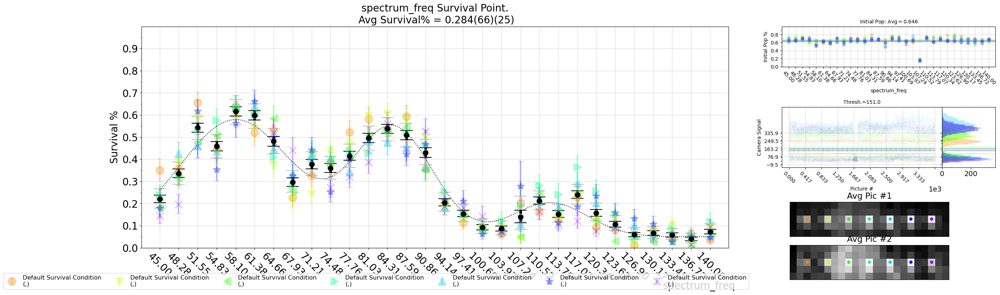

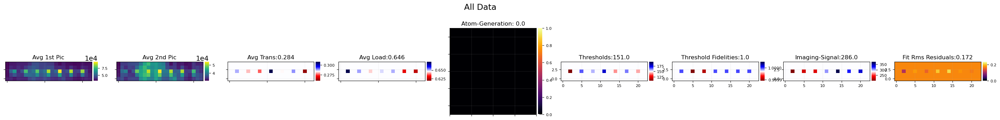

In [15]:
res = mp.Survival( "3DSBC_AXIAL_RAMAN_SPECTROSCOPY", [2,2,3,7,1], forceNoAnnotation=True, 
                   fitModules=bump3_Sym, showFitDetails=False );
dt = exp.getStartDatetime("3DSBC_AXIAL_RAMAN_SPECTROSCOPY")
fitV = res['Average_Transfer_Fit']['vals']
fitE = res['Average_Transfer_Fit']['errs']
sCalData['AxialTrapFreq'] = ca.calPoint(fitV[-1]/2, fitE[-1]/2, dt) 
sCalData['AxialCarrierLocation'] = ca.calPoint(fitV[-2], fitE[-2], dt) 
sCalData['AxialNbar'] = ca.calPoint(bump3_Sym.fitCharacter(fitV), bump3_Sym.fitCharacterErr(fitV, fitE), dt)

### File 3DSBC_TOP_SIDEBAND_RAMAN_SPECTROSCOPY (3DGSBC_Top_Sideband_Spectroscopy)

Number of Pictures: 3750; Picture Dimensions: 5 x 23
Variations: 25;	Repetitions: 75;	Exp File Version: 4;
Experiment started at (H:M:S) 6:19:47: on (Y-M-D) 2021-2-3, And ended at 6:37:34: on 2021-2-3
Experiment Notes: HDF5 NOT ANNOTATED: please call exp.Annotate() to annotate this file.

[7.73337557e-03 1.64195265e-02 6.31664796e-01 7.66764549e-01
 2.13012296e-02 2.39634968e+06 2.64270165e+06]
Avg Fit R-Squared: 0.986


Offset: 0.0390(77)<br>  $A_1$: 0.500(16)<br>  $x_1$: -136.17(63)<br>  $\sigma_1$: 15.73(77)<br>  $A_2$: 0(21)<br>  $x_2$: 0(2400000)<br>  $\sigma_2$: 0(2600000)<br>  $\bar{n}$: 0(43)

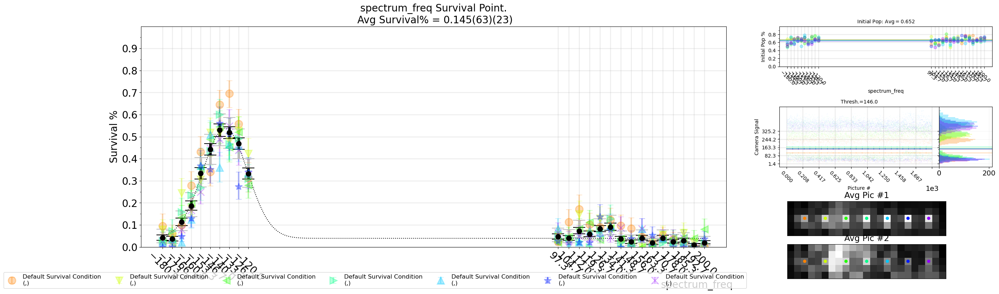

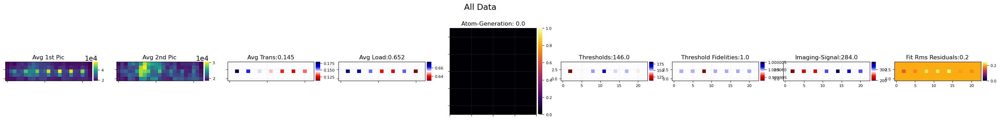

In [16]:
res = mp.Survival("3DSBC_TOP_SIDEBAND_RAMAN_SPECTROSCOPY", [2,2,3,7,1], 
                  fitModules=[bump2], fitguess=[[0,0.3,-150,10, 0.3, 150, 10]], forceNoAnnotation=True);
dt = exp.getStartDatetime("3DSBC_TOP_SIDEBAND_RAMAN_SPECTROSCOPY")
fvals = res['Average_Transfer_Fit']['vals']
ferrs = res['Average_Transfer_Fit']['errs']
sCalData['RadialTrapFreq'] = ca.calPoint((fvals[-2]-fvals[2])/2, np.sqrt(ferrs[-2]**2/4+ferrs[2]**2/4), dt) 
sCalData['RadialNbar'] = ca.calPoint(bump2.fitCharacter(fvals), bump2.fitCharacterErr(fvals, ferrs), dt) 
if sCalData["AxialTrapFreq"] is not None:
    nur = sCalData["RadialTrapFreq"].value
    nuax = sCalData["AxialTrapFreq"].value
    sCalData["SpotSize2Freqs"] = ca.calPoint(ca.getWaistFromBothFreqs(nur,nuax), 0, dt)

### File DEPTH_MEASUREMENT_DEEP (Depth_Measurement_Deep)

Number of Pictures: 2400; Picture Dimensions: 5 x 23
Variations: 12;	Repetitions: 100;	Exp File Version: 4;
Experiment started at (H:M:S) 6:37:34: on (Y-M-D) 2021-2-3, And ended at 6:49:8: on 2021-2-3
Experiment Notes: HDF5 NOT ANNOTATED: please call exp.Annotate() to annotate this file.

[0.03665839 0.01397838 0.01813627 0.02314221]
Avg Fit R-Squared: 0.980


A: -0.710(37)<br>  $x_0$: -1.599(14)<br>  $\sigma$: 0.269(18)<br>  offset: 0.781(23)<br>  $x_0$: -1.599(14)

,A,A-Err,$x_0$,$x_0$-Err,$\sigma$,$\sigma$-Err,offset,offset-Err
fit 0,-0.776514,0.029488,-1.599211,0.010401,0.272199,0.013566,0.917223,0.018786
fit 1,-0.672692,0.084879,-1.567082,0.033654,0.268053,0.043912,0.770879,0.054854
fit 2,-0.744989,0.057501,-1.587611,0.020929,0.270800,0.027293,0.842306,0.036830
fit 3,-0.713589,0.051357,-1.568130,0.017223,0.232549,0.021350,0.762156,0.029850
fit 4,-0.706089,0.042173,-1.620936,0.017895,0.294986,0.024094,0.731159,0.028167
fit 5,-0.682370,0.039934,-1.642118,0.015897,0.262443,0.020357,0.703774,0.023940
fit 6,-0.707090,0.084018,-1.606554,0.033078,0.275975,0.043350,0.739841,0.053782
Mean Val,-0.714762,0.055621,-1.598806,0.021297,0.268144,0.027703,0.781048,0.035173
Median Val,-0.710340,0.053489,-1.599009,0.019412,0.269472,0.025693,0.766517,0.032511
Std Val,0.029248,0.017632,0.022357,0.007233,0.015299,0.009537,0.060647,0.011618


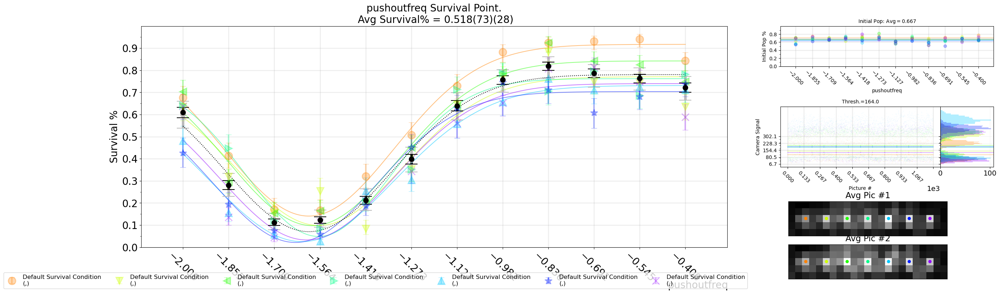

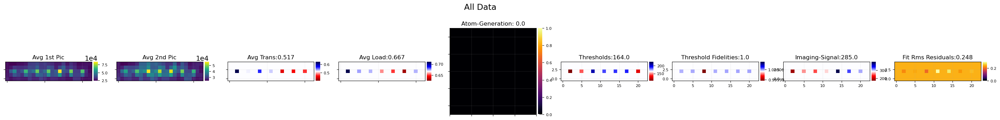

In [17]:
res = mp.Survival("DEPTH_MEASUREMENT_DEEP", [2,2,3,7,1], fitModules=dip, forceNoAnnotation=True, showFitDetails=True);
dt = exp.getStartDatetime("DEPTH_MEASUREMENT_DEEP")
fvals = res['Average_Transfer_Fit']['vals']
ferrs = res['Average_Transfer_Fit']['errs']
sCalData['DeepScatteringResonance'] = ca.calPoint(fvals[1], ferrs[1], dt) 
rdepth = lsc.trapDepthFromDac(sCalData['DeepScatteringResonance'].value)
sCalData['DeepDepth'] = ca.calPoint(rdepth, abs(rdepth-lsc.trapDepthFromDac(sCalData['DeepScatteringResonance'].value+sCalData['DeepScatteringResonance'].error)), dt) 
sCalData['RamanDepth'] = sCalData['DeepDepth']
if sCalData["RadialTrapFreq"] is not None:
    sCalData['SpotSizeRadialDepth'] = ca.calPoint(ca.getWaist_fromRadialFreq(sCalData["RadialTrapFreq"].value*1e3, -rdepth ),
                                               ca.getWaist_fromRadialFreq_err(sCalData["RadialTrapFreq"].value*1e3, 
                                                                           -rdepth, sCalData["RadialTrapFreq"].error*1e3, sCalData['RamanDepth'].error) ,dt)
if sCalData["AxialTrapFreq"] is not None:
    sCalData['SpotSizeAxDepth'] = ca.calPoint(ca.getWaist_fromAxialFreq(sCalData["AxialTrapFreq"].value*1e3, -sCalData['RamanDepth'].value ),0,dt)
sCalData['IndvDeepScatteringResonances'] = [None for _ in res['Transfer_Fits']]
sCalData['IndvRamanDepths'] = [None for _ in res['Transfer_Fits']]
for fitn, fit in enumerate(res['Transfer_Fits']):
    fvals = fit['vals']
    ferrs = fit['errs']
    res = ca.calPoint(fvals[1], ferrs[1], dt) 
    sCalData['IndvDeepScatteringResonances'][fitn] = res
    rdepth = lsc.trapDepthFromDac(res.value)
    sCalData['IndvRamanDepths'][fitn] = ca.calPoint(rdepth, abs(rdepth-lsc.trapDepthFromDac(res.value+res.error)), dt)


### File DEPTH_MEASUREMENT_SHALLOW (Depth_Measurement_Shallow)

Number of Pictures: 6000; Picture Dimensions: 5 x 23
Variations: 15;	Repetitions: 200;	Exp File Version: 4;
Experiment started at (H:M:S) 6:49:8: on (Y-M-D) 2021-2-3, And ended at 7:17:4: on 2021-2-3
Experiment Notes: HDF5 NOT ANNOTATED: please call exp.Annotate() to annotate this file.

[0.02407544 0.00525495 0.00655479 0.0134777 ]
Avg Fit R-Squared: 0.992


A: -0.858(24)<br>  $x_0$: -2.4308(53)<br>  $\sigma$: 0.1767(66)<br>  offset: 0.843(13)<br>  $x_0$: -2.4308(53)

,A,A-Err,$x_0$,$x_0$-Err,$\sigma$,$\sigma$-Err,offset,offset-Err
fit 0,-0.940195,0.040455,-2.435348,0.007772,0.168916,0.009507,0.922826,0.021568
fit 1,-0.901427,0.034592,-2.424361,0.007152,0.175581,0.008894,0.853665,0.019227
fit 2,-0.832626,0.034982,-2.440639,0.007874,0.176816,0.009826,0.832595,0.019601
fit 3,-0.841523,0.035010,-2.429007,0.007643,0.172459,0.009431,0.823268,0.019084
fit 4,-0.789816,0.043962,-2.431914,0.010526,0.178864,0.013205,0.789587,0.024947
fit 5,-0.855859,0.031600,-2.434105,0.007111,0.183183,0.009029,0.827313,0.018427
fit 6,-0.851966,0.020911,-2.419809,0.004716,0.182621,0.005976,0.857166,0.012145
Mean Val,-0.859059,0.034502,-2.430740,0.007542,0.176920,0.009410,0.843774,0.019285
Median Val,-0.853913,0.034787,-2.431327,0.007593,0.176868,0.009420,0.838184,0.019256
Std Val,0.039809,0.005950,0.005729,0.001390,0.004233,0.001725,0.033841,0.003147


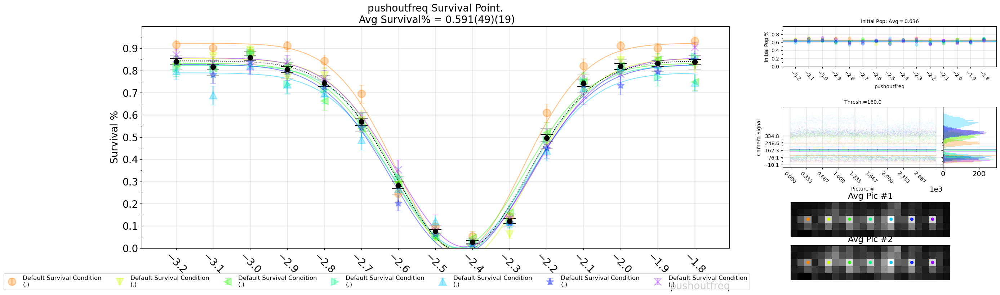

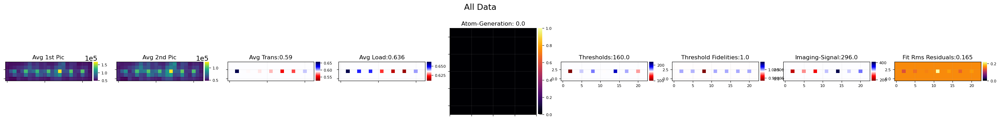

In [18]:
res = mp.Survival("DEPTH_MEASUREMENT_SHALLOW", [2,2,3,7,1], fitModules=dip, forceNoAnnotation=True, showFitDetails=True);
dt = exp.getStartDatetime("DEPTH_MEASUREMENT_SHALLOW")
fvals = res['Average_Transfer_Fit']['vals']
ferrs = res['Average_Transfer_Fit']['errs']
sCalData['ShallowScatteringResonance'] = ca.calPoint(fvals[1], ferrs[1], dt)
# bit of a cheap error calculation here
sCalData['ShallowDepth'] = ca.calPoint(lsc.trapDepthFromDac(sCalData['ShallowScatteringResonance'].value),
                                    abs(lsc.trapDepthFromDac(sCalData['ShallowScatteringResonance'].value)
                                        -lsc.trapDepthFromDac(sCalData['ShallowScatteringResonance'].value+sCalData['ShallowScatteringResonance'].error)), 
                                    dt) 
if sCalData['DeepScatteringResonance'] is not None:
    sCalData['ResonanceDelta'] = ca.calPoint(sCalData['DeepScatteringResonance'].value - sCalData['ShallowScatteringResonance'].value, 
                                          np.sqrt(sCalData['DeepScatteringResonance'].error**2+sCalData['ShallowScatteringResonance'].error**2), dt)
    sCalData['ResonanceDepthDelta'] = ca.calPoint( sCalData['DeepDepth'].value-sCalData['ShallowDepth'].value, 
                                                np.sqrt(sCalData['DeepDepth'].error**2+sCalData['ShallowDepth'].error**2), dt)

### File LIFETIME_MEASUREMENT (Lifetime_Measurement)

Number of Pictures: 1280; Picture Dimensions: 5 x 23
Variations: 8;	Repetitions: 80;	Exp File Version: 4;
Experiment started at (H:M:S) 7:17:5: on (Y-M-D) 2021-2-3, And ended at 7:59:39: on 2021-2-3
Experiment Notes: HDF5 NOT ANNOTATED: please call exp.Annotate() to annotate this file.

[3.28003298e-02 3.16466972e+02]
Avg Fit R-Squared: 0.982


Amplitude: 1.029(33)<br>  Decay-Constant: 4960(320)<br>  Decay Constant: 4960(320)

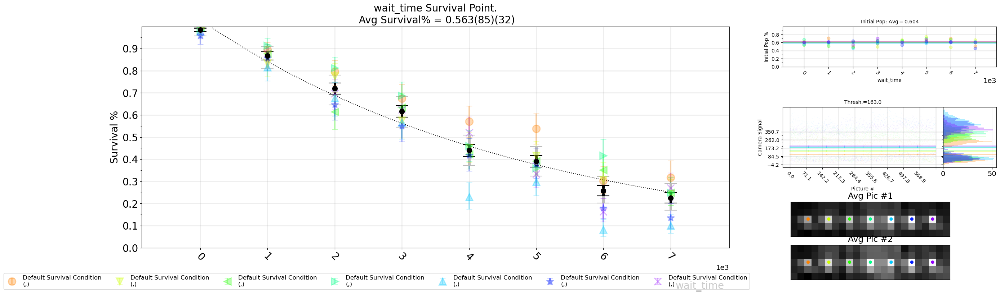

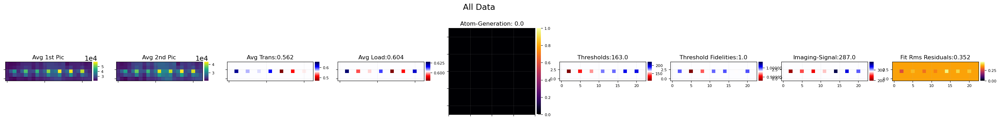

In [19]:
decay.limit = 0
res = mp.Survival("LIFETIME_MEASUREMENT", [2,2,3,7,1], fitModules=decay, forceNoAnnotation=True);
dt = exp.getStartDatetime("LIFETIME_MEASUREMENT")
fit = res['Average_Transfer_Fit']
sCalData['LifeTime'] = ca.calPoint(fit['vals'][1], fit['errs'][1], dt)

In [20]:
with open(exp.dataAddress + 'CalibrationData.p','wb') as calFile:
    pickle.dump(sCalData, calFile)



## Calibration Summmary

In [21]:
reloadMyModules()

NameError: name 'reloadMyModules' is not defined

In [23]:
def plotCalData(ax, dataV, pltargs={}, sf=1):
    err = np.array(np.array([data.error for data in dataV]).tolist())
    if len(np.array(err).shape) == 2:
        err = misc.transpose(err)
    ax.errorbar([data.timestamp for data in dataV], [data.value*sf for data in dataV], 
                yerr=err, **pltargs)

In [24]:
def addAnnotations(ax):
    ax.axvline(datetime(2020,6,20), color='k')
    ax.text(datetime(2020,6,20),0.5, 'Chimera 2.0', transform=ax.get_xaxis_transform(), color='k', rotation=-90)
    ax.axvline(datetime(2020,7,11), color='k')
    ax.text(datetime(2020,7,11), 0.5, "Mark's Vacation", transform=ax.get_xaxis_transform(), color='k', rotation=-90)
    ax.axvline(datetime(2020,7,21), color='k')
    ax.text(datetime(2020,7,21), 0.5, "Changed to 7 Atoms", transform=ax.get_xaxis_transform(), color='k', rotation=-90)
    ax.axvline(datetime(2020,9,21), color='k')
    ax.text(datetime(2020,9,21), 0.5, "Sprout Issues;\nSwitch To TA", transform=ax.get_xaxis_transform(), color='k', rotation=-90)
    ax.axvline(datetime(2020,12,1), color='k')
    ax.text(datetime(2020,12,1), 0.5, "Switch to GSBC", transform=ax.get_xaxis_transform(), color='k', rotation=-90)

def setAxis(ax, dataV=None, color='r', pad=0):
    ax.spines['right'].set_color(color)
    ax.yaxis.label.set_color(color)
    ax.tick_params(axis='y', colors=color)
    ax.tick_params(axis='y', which='major', pad=pad)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(alpha=0.15)
    ax.xaxis.set_major_locator(mdates.DayLocator(interval=7))
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%b-%d'))
    addAnnotations(ax)

def makeLegend(ax, loc = 'upper left', bbox=(0,1.05)):
    leg = ax.legend(loc=loc, bbox_to_anchor=bbox, ncol=3, framealpha=1)
    for text in leg.get_texts():
        text.set_color("k")

In [25]:
# load all past calibration data into a bigger strucutre.
ea = np.array([])
calData = {"Loading":ea,"ImagingSurvival":ea,"MOT_Size":ea,"MOT_FillTime":ea, "MOT_Temperature":ea,
           "RPGC_Temperature":ea,"LGM_Temperature":ea,"ThermalTrapFreq":ea, "ThermalNbar":ea, 
           "AxialTrapFreq":ea, "AxialCarrierLocation":ea, "AxialNbar":ea, "RadialTrapFreq":ea,
           "RadialNbar":ea, "RadialCarrierLocation":ea, "DeepScatteringResonance":ea, "DeepDepth":ea, 
           "ShallowScatteringResonance":ea, "ShallowDepth":ea, "ResonanceDelta":ea, "SpotSize2Freqs":ea, 
           "SpotSizeRadialDepth":ea, "SpotSizeAxDepth":ea, "RamanDepth":ea, "ResonanceDepthDelta":ea, "IndvRamanDepths":ea, "LifeTime": ea }
for year_ in ['2020','2021']:
    for month_ in ['january', 'february', 'march', 'april', 'may', 'june', 'july', 'august', 'september', 'october', 'november','december']:
        print(month_,end=',')
        for d in range(1,32):
            exp.setPath(str(d),month_, year_)
            try:
                with open(exp.dataAddress + 'CalibrationData.p', 'rb') as handle:
                    readCalData = pickle.loads(handle.read())
                for key in calData.keys():
                    if key in readCalData:
                        if readCalData[key] is not None:
                            # the data gets set to none if, e.g. there's a bad calibation set which was never fixed that day. 
                            calData[key] = np.append(calData[key], readCalData[key])
            except OSError:
                pass
reloadMyModules(day_=day)

january,february,march,april,may,june,

AttributeError: Can't get attribute 'calPoint' on <module '__main__'>

In [ ]:
matplotlib.style.use('default')
fs = 20
fig, axs = plt.subplots(8,1, figsize=(20,35))
plt.subplots_adjust(hspace=0.3)

# ###################################
# ###################################
motAx = axs[0]
motAx_2 = motAx.twinx()
motAx_3 = motAx.twinx()
plotCalData(motAx, calData['MOT_Temperature'], {'marker':'o','label':'MOT_Temperature','capsize':5, 'color':'r'})
plotCalData(motAx_2, calData['MOT_FillTime'], {'marker':'o','label':'MOT_FillTime','capsize':5, 'color':'b'})
plotCalData(motAx_3, calData['MOT_Size'], {'marker':'o','label':'MOT_Size','capsize':5, 'color':'g'})
motAx_2.set_title('MOT Characteristics', color='k', fontsize=fs)
motAx.set_ylabel(r'MOT Temperature ($\mu K$)', fontsize=fs)
motAx_2.set_ylabel(r'MOT Fill-Time', fontsize=fs)
motAx_3.set_ylabel(r'MOT Size', fontsize=fs)
makeLegend(motAx)
makeLegend(motAx_2, 'upper right', (1,1.08))
makeLegend(motAx_3, 'upper right', (1,1.15))
motAx.set_ylabel(r'MOT Temperature ($\mu K$)', fontsize=fs)
motAx_2.set_ylabel(r'MOT Fill Time (Seconds)', fontsize=fs)
motAx_3.set_ylabel(r'MOT Size (# Atoms)', fontsize=fs)
setAxis(motAx, calData['MOT_Temperature'], color='r', pad=0)
setAxis(motAx_2, color='b', pad=0)
setAxis(motAx_3, color='g', pad=50)
# ###################################
# ###################################
ax2 = axs[1]
ax2_MOT = ax2.twinx()
plotCalData(ax2_MOT, calData['MOT_Temperature'], {'marker':'o','label':'MOT_Temperature','capsize':5, 'color':'r'})
plotCalData(ax2, calData['RPGC_Temperature'], {'marker':'o','label':'RPGC_Temperature','capsize':5, 'color':'b'})
plotCalData(ax2, calData['LGM_Temperature'], {'marker':'o','label':'LGM_Temperature','capsize':5, 'color':'g'})
makeLegend(ax2)
makeLegend(ax2_MOT, 'upper right', (1,1.05))
setAxis(ax2, color='k')
setAxis(ax2_MOT)
ax2.set_title("Free Spacing Cooling Techniques", fontsize=fs)
ax2_MOT.set_ylabel(r'MOT Temperature ($\mu K$)', fontsize=fs)
ax2.set_ylabel(r'PGC Temperature ($\mu K$)', fontsize=fs)
# ###################################
# ###################################
probAx = axs[2]
probAx.set_title('Basic Atom', color='k', fontsize=fs)
lifeAx = probAx.twinx()
plotCalData(probAx, calData['Loading'], {'marker':'o','label':'Loading','capsize':5})
plotCalData(probAx, calData['ImagingSurvival'], {'marker':'o','label':'ImagingSurvival','capsize':5})
plotCalData(lifeAx, calData['LifeTime'], {'marker':'o','label':'Lifetime','capsize':5, 'color':'r'})
probAx.set_ylim(0,1)
probAx.set_ylabel('Probability (/1)', fontsize=fs)
lifeAx.set_ylabel('Lifetime (ms)', fontsize=fs)
setAxis(probAx, color='k')
makeLegend(probAx)
setAxis(lifeAx, color='r')
makeLegend(lifeAx)
# ###################################
# ###################################
trapAx_rfreqs = axs[3]
trapAx_axfreqs = trapAx_rfreqs.twinx()
plotCalData(trapAx_rfreqs, calData['ThermalTrapFreq'], {'linestyle':':','marker':'o','label':'ThermalTrapFreq','capsize':5, 'color':'r'})
plotCalData(trapAx_rfreqs, calData['RadialTrapFreq'], {'marker':'o','label':'RadialTrapFreq','capsize':5, 'color':'b'})
plotCalData(trapAx_axfreqs, calData['AxialTrapFreq'], {'marker':'o','label':'AxialTrapFreq','capsize':5, 'color':'c'})

trapAx_rfreqs.set_ylabel('Radial Trap Frequencies', fontsize=fs)
trapAx_axfreqs.set_ylabel('Axial Trap Frequencies', fontsize=fs)

trapAx_rfreqs.set_ylim(120,170)
trapAx_axfreqs.set_ylim(25,40)

makeLegend(trapAx_rfreqs, 'upper right', (1, 1.1))
makeLegend(trapAx_axfreqs, 'upper right', (1,1.2))
setAxis(trapAx_rfreqs, color='b')
setAxis(trapAx_axfreqs, color='c', pad=100)

# ###################################
# ###################################

trapAx_depths = axs[4]
trapAx_sizes = axs[5]
trapAx_resonances = trapAx_depths.twinx()


plotCalData(trapAx_depths, calData['ShallowDepth'], {'linestyle':':','marker':'o','label':'ShallowDepth','capsize':5, 'color':'g'})
plotCalData(trapAx_depths, calData['DeepDepth'], {'linestyle':'--','marker':'o','label':'DeepDepth','capsize':5, 'color':'g'})
plotCalData(trapAx_depths, calData['RamanDepth'], {'linestyle':'-','marker':'o','label':'RamanDepth','capsize':5, 'color':'g'})

plotCalData(trapAx_sizes, calData['SpotSize2Freqs'],{'linestyle':':','marker':'o','label':'SpotSize2Freqs','capsize':5, 'color':'r'}, sf=1e9)
plotCalData(trapAx_sizes, calData['SpotSizeRadialDepth'],{'linestyle':'-','marker':'o','label':'SpotSizeRadialDepth','capsize':5, 'color':'r'}, sf=1e9)
plotCalData(trapAx_sizes, calData['SpotSizeAxDepth'],{'linestyle':'--','marker':'o','label':'SpotSizeAxDepth','capsize':5, 'color':'r'}, sf=1e9)

plotCalData(trapAx_resonances, calData['ResonanceDepthDelta'], {'marker':'o','label':'ResonanceDelta','capsize':5, 'color':'k'})

trapAx_sizes.set_ylabel('Spot Sizes (nm)', fontsize=fs)
trapAx_depths.set_ylabel('Depth (V)', fontsize=fs)
trapAx_resonances.set_ylabel('Depth Delta (V)', fontsize=fs)
trapAx_resonances.yaxis.tick_left()
trapAx_resonances.yaxis.set_label_position("left")
trapAx_resonances.set_ylim(-1.5,0)
trapAx_depths.set_title('Trap Characterization', color='k', fontsize=fs)

makeLegend(trapAx_resonances, 'upper left', (0,1.1))

setAxis(trapAx_resonances, color='k', pad=50)
setAxis(trapAx_sizes, color='r', pad=50)
setAxis(trapAx_depths, color='g')

makeLegend(trapAx_sizes, 'upper right', (1,1.15))
makeLegend(trapAx_depths, 'upper left', (0,1.15))
# ###################################
# ###################################
ax = axs[6]
ax.set_title('NBar Values', color='k', fontsize=fs)
plotCalData(ax, calData['ThermalNbar'], {'marker':'o','label':'ThermalNbar','capsize':5})
plotCalData(ax, calData['AxialNbar'], {'marker':'o','label':'AxialNbar','capsize':5})
plotCalData(ax, calData['RadialNbar'], {'marker':'o','label':'RadialNbar','capsize':5})
ax.set_ylim(0,2)
makeLegend(ax)
setAxis(ax)
# ###################################
# ###################################
carrierAx = axs[7]
carrierAx.set_title('Carrier Drift', color='k', fontsize=fs)
plotCalData(carrierAx, calData['RadialCarrierLocation'], {'marker':'o','label':'Radial Carrier Location','capsize':5})

setAxis(carrierAx, color='k')
makeLegend(carrierAx, loc="upper right", bbox=(1,1.05))
matplotlib.style.use('default')
carrierAx.axvline(datetime(2020,6,16))
carrierAx.text(datetime(2020,6,16),0.5, 'Started Recording\nAbosolute Freq', transform=carrierAx.get_xaxis_transform(), color='k');
display(carrierAx);

# Today's Work

J/U ~ 3 = A / V^(3/2)

$U = J V^{3/2}/A = B \times V^{3/2}$

In [46]:
A = 3*(15e3)**(3/2)
B = 125/A

In [ ]:
0.0075          140 Hz      1.5 kHz     1 KHz
0.01            110 Hz      2 kHz       1.5 kHz
0.0125          95 Hz       2.5 kHz     2.1 kHz
0.02            45 Hz       4 kHz       4.3 KHz
0.025           26 Hz       5 kHz       8 kHz

In [50]:
for V, J in zip([1.5,2,2.5,4,5], [140, 110, 95, 45, 26]):
    Vv = V*1e3
    U = B*Vv**(3/2)
    print(J/U,U)

106.25252938165755 1.3176156917368247
54.224533193011446 2.0286020648339487
33.50901968127388 2.8350575726657152
7.842791276070019 5.7377531054924695
3.2423991117689384 8.018753738744802


### File 14 (AdiabaticIntensityInitBiasPerturb): perterb tunneling time scan

Number of Pictures: 5400; Picture Dimensions: 5 x 11
Variations: 9;	Repetitions: 300;	Exp File Version: 4;
Experiment started at (H:M:S) 18:27:24: on (Y-M-D) 2021-2-2, And ended at 19:6:35: on 2021-2-2
Experiment Notes: okay, I think this is slow ish, maybe I left the perturbation amouunt small?



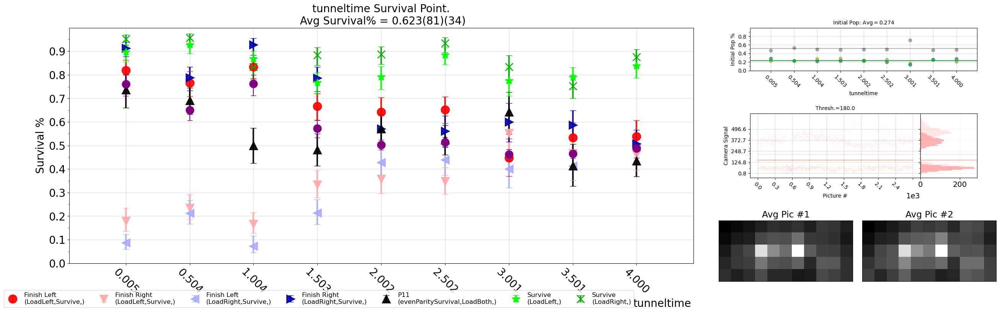

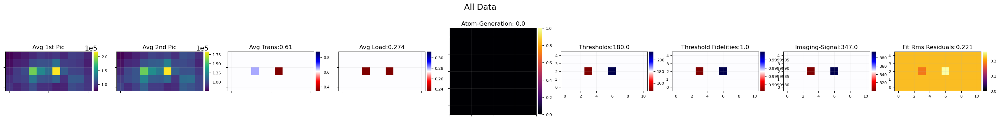

In [56]:
mp.Tunneling(14, [[2,3]],[[2,6]], includeSurvival=True, includeHOM=True);

### File 15 (AdiabaticIntensityInitBiasPerturb): better magnitude & timing scan

Number of Pictures: 5400; Picture Dimensions: 5 x 11
Variations: 9;	Repetitions: 300;	Exp File Version: 4;
Experiment started at (H:M:S) 19:11:52: on (Y-M-D) 2021-2-2, And ended at 19:51:1: on 2021-2-2
Experiment Notes: okay nw I'm seeing oscillations, and as usual looks like the p11 not particularly great



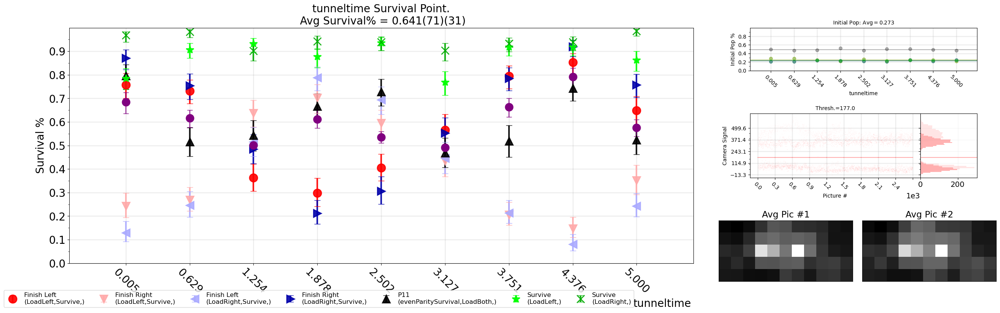

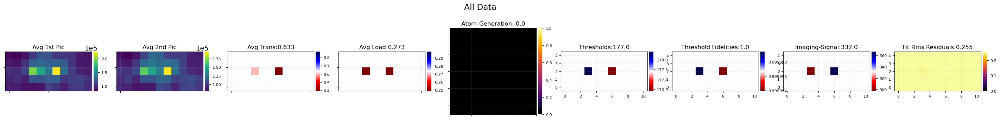

In [87]:
mp.Tunneling(15, [[2,3]],[[2,6]], includeSurvival=True, includeHOM=True);

Opening Basler Images.


C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:829: OptimizeWarning:

Covariance of the parameters could not be estimated



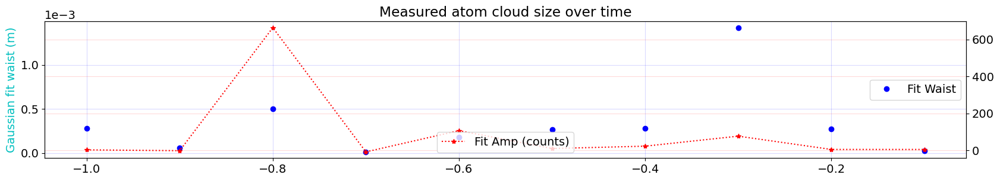

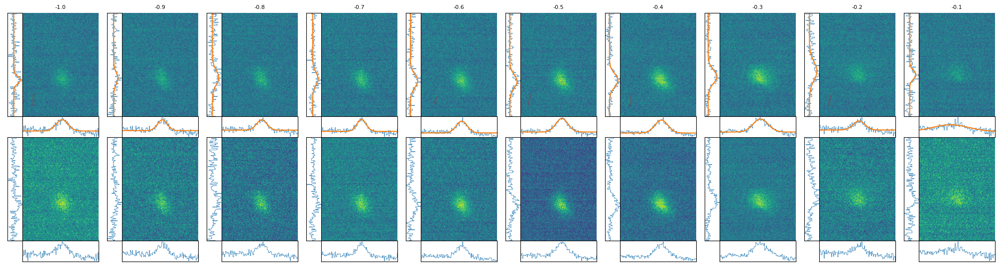

In [140]:
mp.plotImages(20,reps=6, fitWidthGuess=5, window=pw.PictureWindow(xmin=70,xmax=-70,ymin=70,ymax=-70), individualColorBars=True);

In [152]:
reloadMyModules()

In [153]:
reload(LargeBeamMotExpansion)

<module 'Analysis_Python_Files.fitters.LargeBeamMotExpansion' from 'C:\\Users\\Regal-Lab\\Code\\Data-Analysis-Code\\Analysis_Python_Files\\fitters\\LargeBeamMotExpansion.py'>

Opening Basler Images.

Temperture in the Large Laser Beam Approximation (2D Fits): 18(19) uK

Temperture in the Large Laser Beam Approximation (1D Fits): 1800(1400) uK
2D Fit-Parameters: [1.91631411e-03 1.62670059e-04 1.81060015e-05]


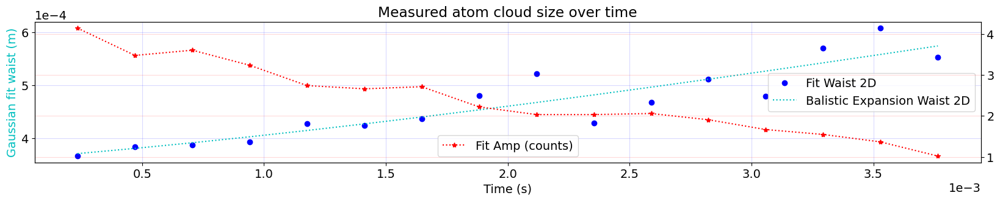

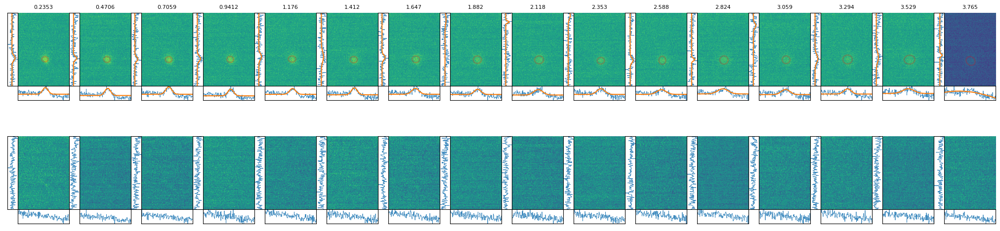

In [155]:
res = mp.plotMotTemperature(21, reps=6, fitWidthGuess=3, window=pw.PictureWindow(xmin=30, xmax=175, ymin=35, ymax=240));
dt = exp.getStartDatetime(21)
sCalData['RPGC_Temperature'] = calPoint(res[-2], res[-1], dt)

Opening Basler Images.

Temperture in the Large Laser Beam Approximation (2D Fits): 244(45) uK

Temperture in the Large Laser Beam Approximation (1D Fits): 0(160) uK
2D Fit-Parameters: [-0.00023652  0.0002148   0.0002444 ]


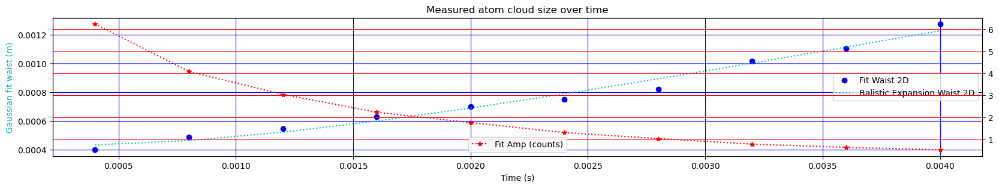

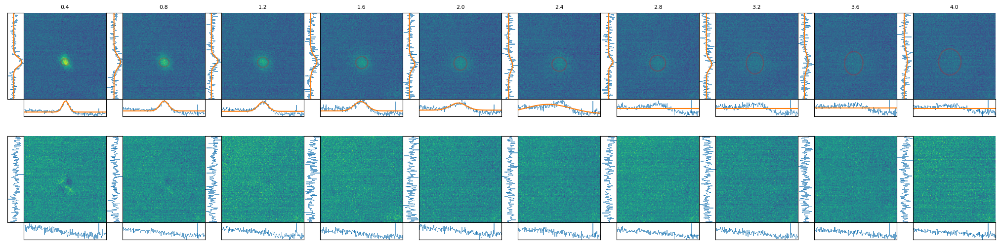

In [166]:
res = mp.plotMotTemperature(22, reps=15, fitWidthGuess=3, window=pw.PictureWindow(xmin=30, xmax=225, ymin=35, ymax=240));
dt = exp.getStartDatetime(22)
sCalData['MOT_Temperature'] = calPoint(res[-2],res[-1],dt) 

Opening Basler Images.
lastdataisbackground: (150, 391, 341)


C:\Users\Regal-Lab\Code\Data-Analysis-Code\Analysis_Python_Files\AnalysisHelpers.py:536: RuntimeWarning:

invalid value encountered in sqrt

C:\Users\Regal-Lab\Code\Data-Analysis-Code\Analysis_Python_Files\AnalysisHelpers.py:527: UserWarning:

Horizontal Average Picture Fitting Failed!




Temperture in the Large Laser Beam Approximation (2D Fits): 11.7(81) uK

Temperture in the Large Laser Beam Approximation (1D Fits): 0(720000) uK
2D Fit-Parameters: [ 7.50041523e-03 -9.12040041e-08  1.17194578e-05]


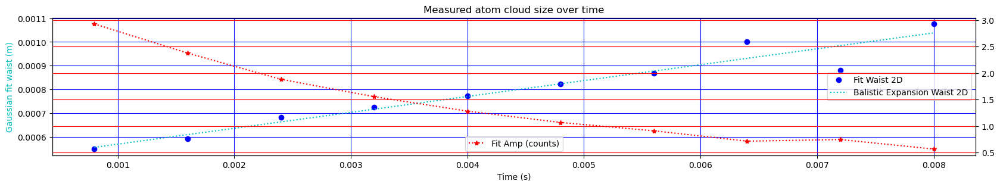

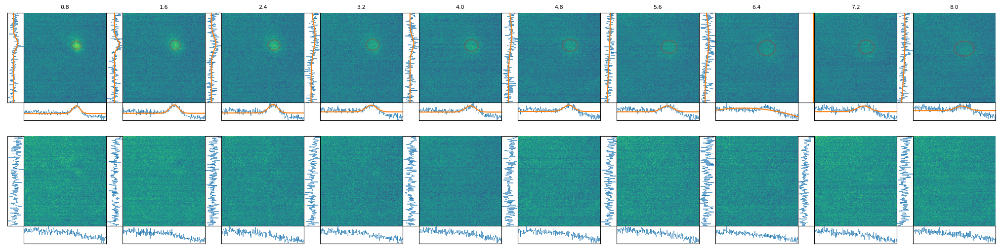

In [179]:
res = mp.plotMotTemperature(23, reps=15, fitWidthGuess=3, window=pw.PictureWindow(xmin=30, xmax=255, ymin=35, ymax=280), lastDataIsBackground=True);
dt = exp.getStartDatetime(22)
#sCalData['MOT_Temperature'] = calPoint(res[-2],res[-1],dt) 

### File 24 (AdiabaticIntensityInitBiasPerturb): 50ms ramp time scan

Number of Pictures: 8100; Picture Dimensions: 5 x 11
Variations: 9;	Repetitions: 450;	Exp File Version: 4;
Experiment started at (H:M:S) 21:53:49: on (Y-M-D) 2021-2-2, And ended at 23:2:20: on 2021-2-2
Experiment Notes: hmm, like one good point there



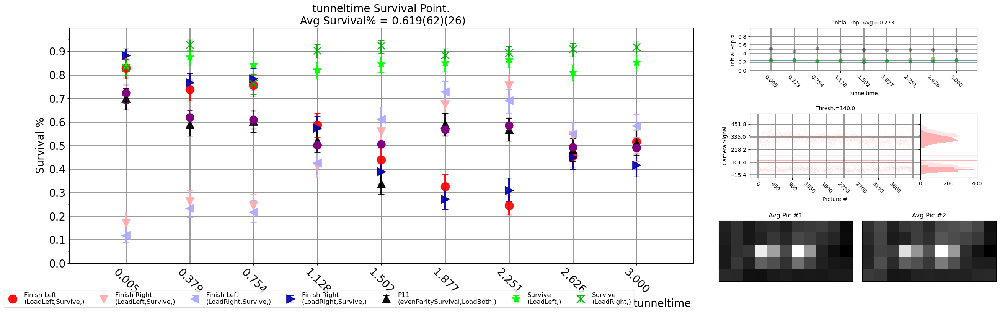

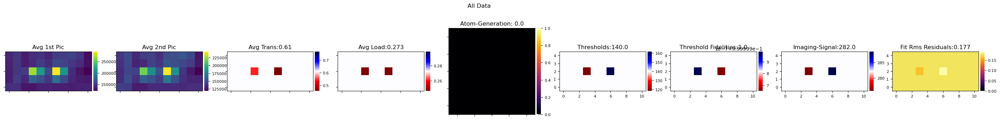

In [186]:
mp.Tunneling(24, [[2,3]],[[2,6]], includeSurvival=True, includeHOM=True);

### File 25 (AdiabaticIntensityInitBiasPerturb): 25ms ramp time

Number of Pictures: 8100; Picture Dimensions: 5 x 11
Variations: 9;	Repetitions: 450;	Exp File Version: 4;
Experiment started at (H:M:S) 23:22:16: on (Y-M-D) 2021-2-2, And ended at 0:14:7: on 2021-2-3
Experiment Notes: worse if anything



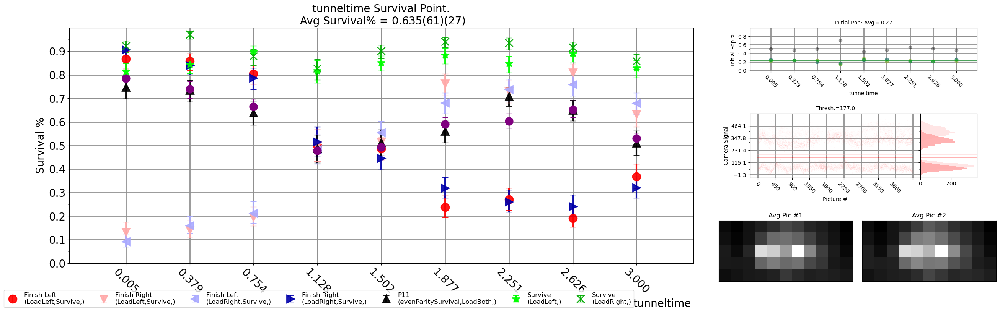

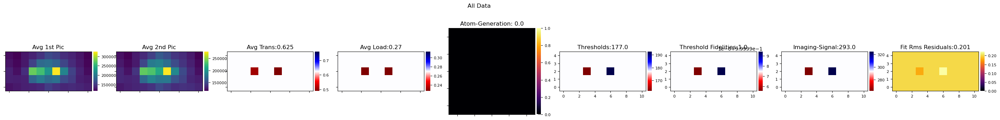

In [187]:
mp.Tunneling(25, [[2,3]],[[2,6]], includeSurvival=True, includeHOM=True);

In [189]:
reloadMyModules(day_='3')

### File 1 (AdiabaticIntensityInitBiasPerturb): 10ms ramp time

Number of Pictures: 8100; Picture Dimensions: 5 x 11
Variations: 9;	Repetitions: 450;	Exp File Version: 4;
Experiment started at (H:M:S) 0:18:26: on (Y-M-D) 2021-2-3, And ended at 1:0:34: on 2021-2-3
Experiment Notes: this is surprisingly good, although p11 still not particularly great, but interesting



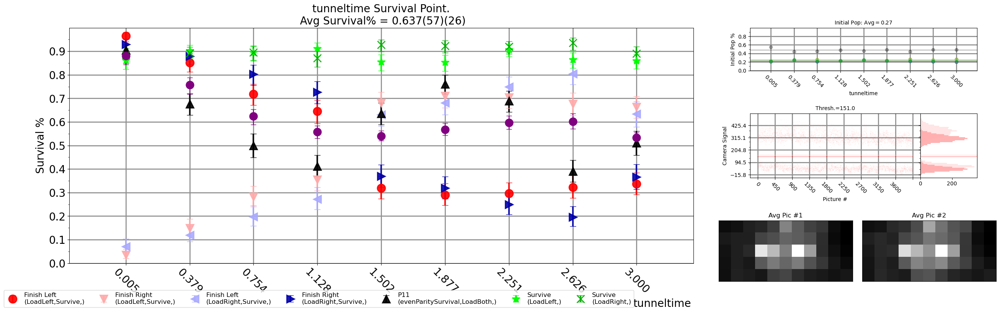

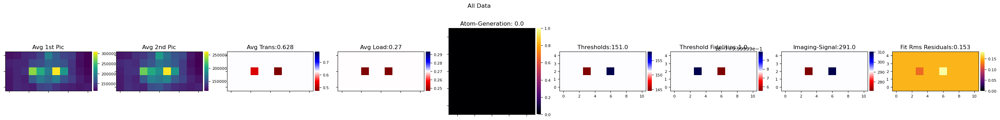

In [190]:
mp.Tunneling(1, [[2,3]],[[2,6]], includeSurvival=True, includeHOM=True);

### File 2 (AdiabaticIntensityInitBiasPerturb): 5ms ramp time

Number of Pictures: 42000; Picture Dimensions: 5 x 11
Variations: 35;	Repetitions: 600;	Exp File Version: 4;
Experiment started at (H:M:S) 1:37:48: on (Y-M-D) 2021-2-3, And ended at 4:54:41: on 2021-2-3
Experiment Notes: wow. really? need to look harder...



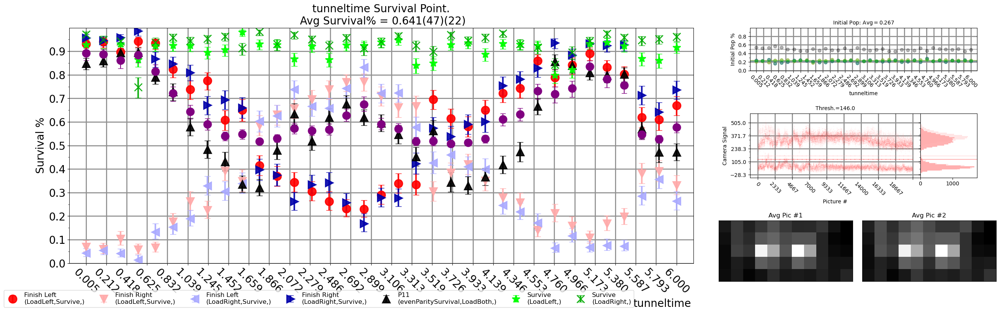

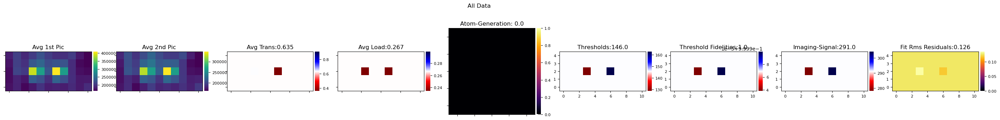

In [191]:
mp.Tunneling(2, [[2,3]],[[2,6]], includeSurvival=True, includeHOM=True);

### File 16 (AdiabaticIntensityInitBiasPerturb): 1ms ramp time

Number of Pictures: 9000; Picture Dimensions: 5 x 11
Variations: 10;	Repetitions: 450;	Exp File Version: 4;
Experiment started at (H:M:S) 15:45:55: on (Y-M-D) 2021-2-3, And ended at 16:26:12: on 2021-2-3
Experiment Notes: okay this looks much worse now. makes sense! actually prety glad to see that.



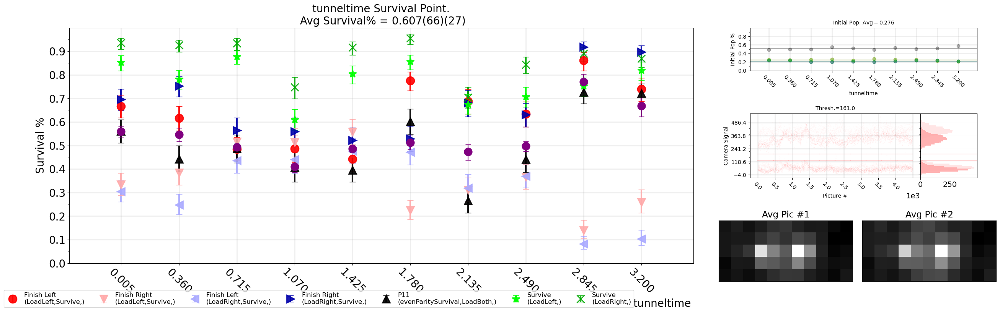

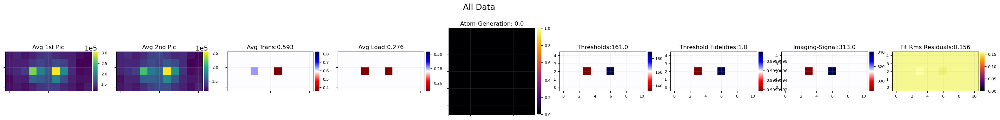

In [38]:
mp.Tunneling(16, [[2,3]],[[2,6]], includeSurvival=True, includeHOM=True);

### File 17 (AdiabaticIntensityInitBiasPerturb): 3ms ramp time

Number of Pictures: 9000; Picture Dimensions: 5 x 11
Variations: 10;	Repetitions: 450;	Exp File Version: 4;
Experiment started at (H:M:S) 16:28:18: on (Y-M-D) 2021-2-3, And ended at 17:10:3: on 2021-2-3
Experiment Notes: okay I think this looks pretty bad as well, so looks like 5-10 ms is best?



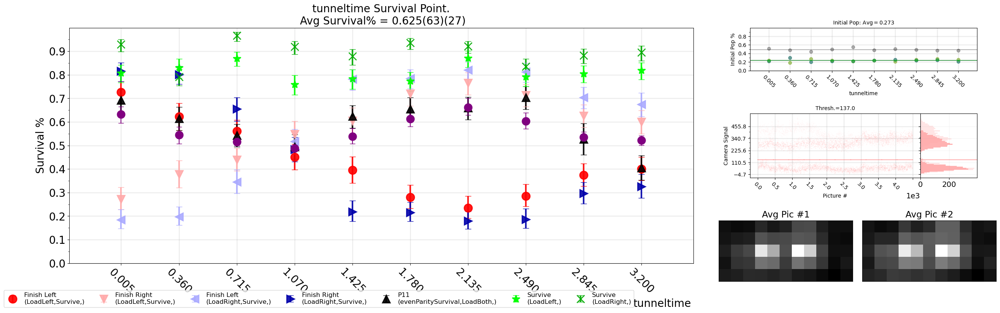

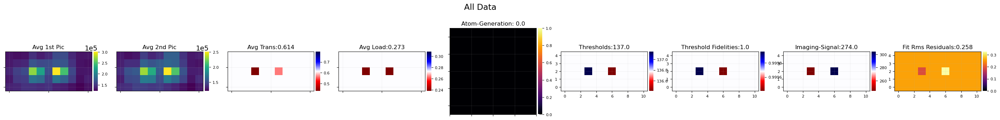

In [39]:
mp.Tunneling(17, [[2,3]],[[2,6]], includeSurvival=True, includeHOM=True);

### File 18 (AdiabaticIntensityInitBiasPerturb): 15ms ramp

Number of Pictures: 9000; Picture Dimensions: 5 x 11
Variations: 10;	Repetitions: 450;	Exp File Version: 4;
Experiment started at (H:M:S) 17:15:56: on (Y-M-D) 2021-2-3, And ended at 18:6:17: on 2021-2-3
Experiment Notes: okay this looks worse again. so does look like 5-10ms or so may be a sweet spot



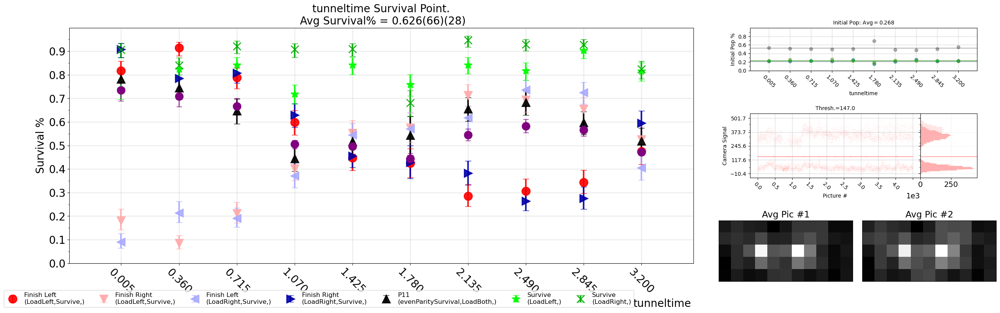

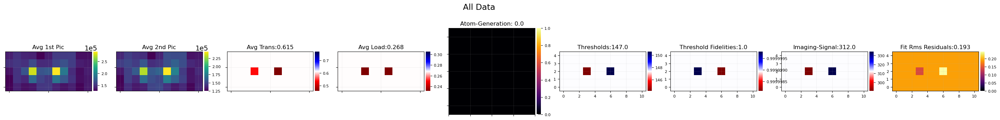

In [24]:
mp.Tunneling(18, [[2,3]],[[2,6]], includeSurvival=True, includeHOM=True);

### File 19 (AdiabaticIntensityInitDiabaticStop): diabatic stop 15ms ramp

Number of Pictures: 2000; Picture Dimensions: 5 x 11
Variations: 1;	Repetitions: 1000;	Exp File Version: 4;
Experiment started at (H:M:S) 18:21:1: on (Y-M-D) 2021-2-3, And ended at 18:30:33: on 2021-2-3
Experiment Notes: hmm, really? this is pretty bad. indicates that not really doing adiabatic state prep even at 15 ms if I believe htis...



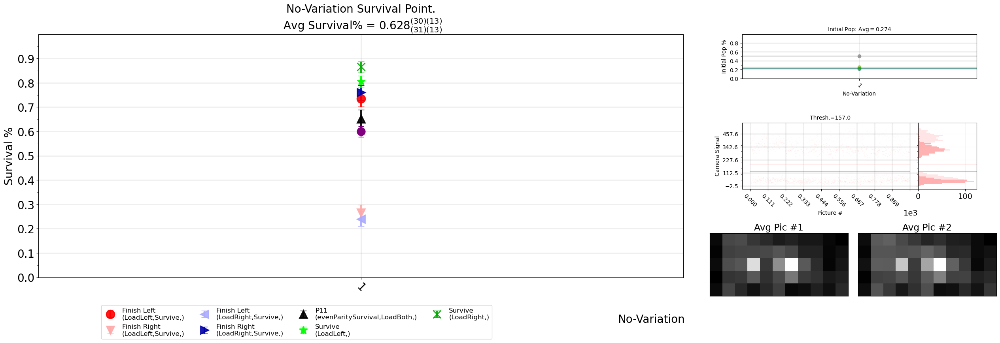

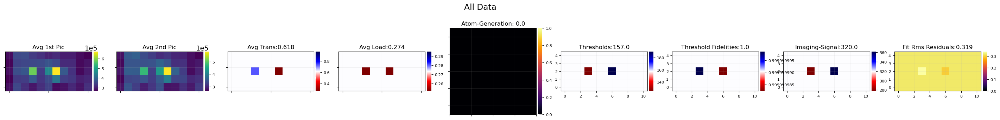

In [25]:
mp.Tunneling(19, [[2,3]],[[2,6]], includeSurvival=True, includeHOM=True);

### File 20 (AdiabaticIntensityInitDiabaticStop): diabatic stop 25ms ramp

Number of Pictures: 2000; Picture Dimensions: 5 x 11
Variations: 1;	Repetitions: 1000;	Exp File Version: 4;
Experiment started at (H:M:S) 18:32:44: on (Y-M-D) 2021-2-3, And ended at 18:42:43: on 2021-2-3
Experiment Notes: okay maybe the new config isn't working?



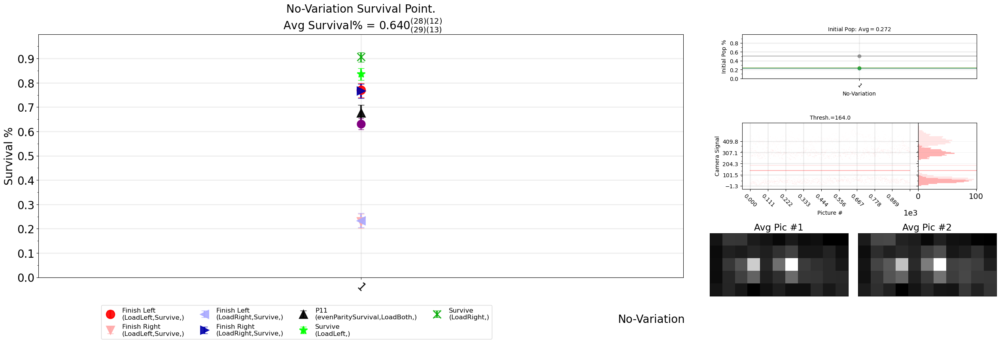

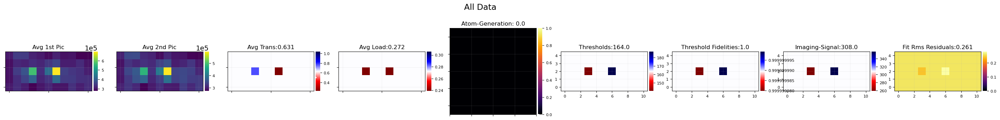

In [22]:
mp.Tunneling(20, [[2,3]],[[2,6]], includeSurvival=True, includeHOM=True);

### File 21 (AdiabaticIntensityInitDiabaticStop): 5ms init ramp

Number of Pictures: 2000; Picture Dimensions: 5 x 11
Variations: 1;	Repetitions: 1000;	Exp File Version: 4;
Experiment started at (H:M:S) 18:45:11: on (Y-M-D) 2021-2-3, And ended at 18:54:15: on 2021-2-3
Experiment Notes: pretty darn similar, maybe a good sign?



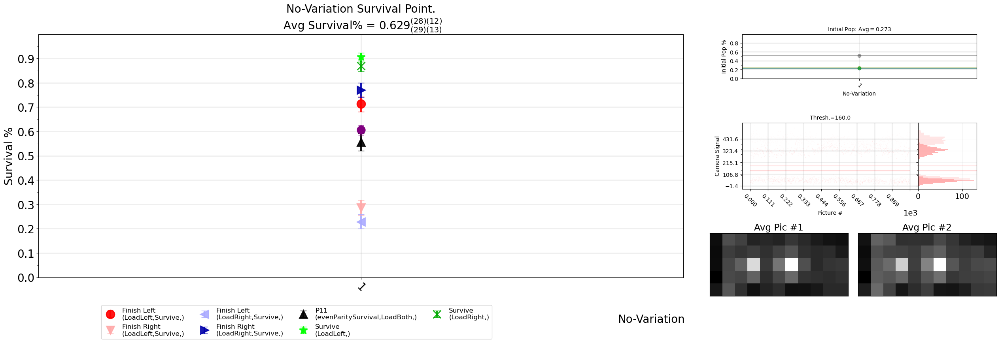

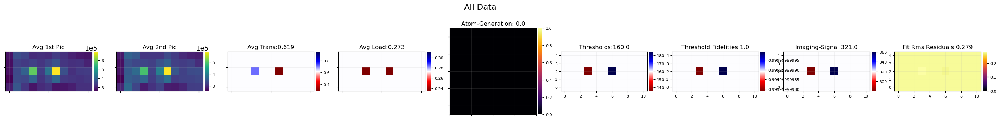

In [29]:
mp.Tunneling(21, [[2,3]],[[2,6]], includeSurvival=True, includeHOM=True);

### File 22 (AdiabaticIntensityInitDiabaticStop): 1ms init

Number of Pictures: 2000; Picture Dimensions: 5 x 11
Variations: 1;	Repetitions: 1000;	Exp File Version: 4;
Experiment started at (H:M:S) 18:58:45: on (Y-M-D) 2021-2-3, And ended at 19:7:37: on 2021-2-3
Experiment Notes: okay now it looks like theres at least less transfer, which makes sense for faster init. so at least there's that.



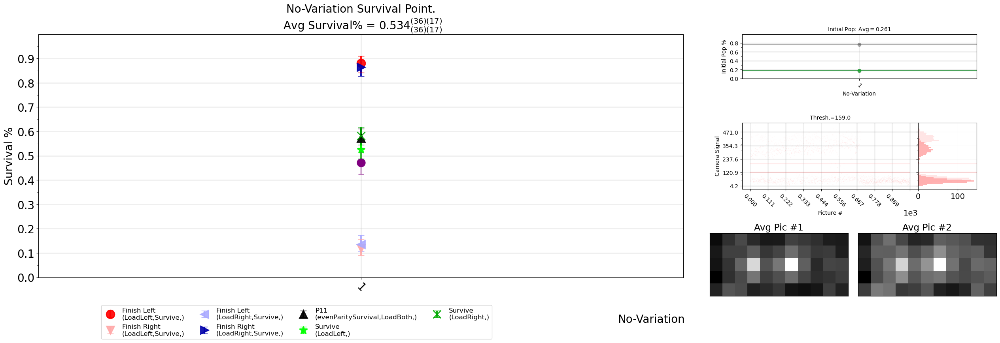

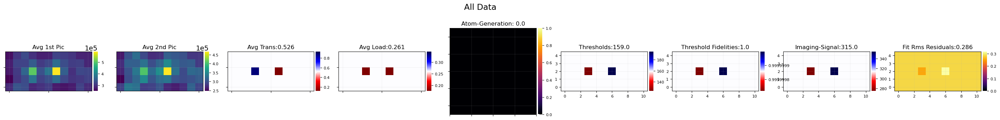

In [30]:
mp.Tunneling(22, [[2,3]],[[2,6]], includeSurvival=True, includeHOM=True);

### File 24 (AdiabaticIntensityInitBiasPerturb): time scan with very small perturb 5ms ramp

Number of Pictures: 9000; Picture Dimensions: 5 x 11
Variations: 10;	Repetitions: 450;	Exp File Version: 4;
Experiment started at (H:M:S) 19:14:50: on (Y-M-D) 2021-2-3, And ended at 19:58:4: on 2021-2-3
Experiment Notes: okay this is a good sign, if diabatic would still see oscillations



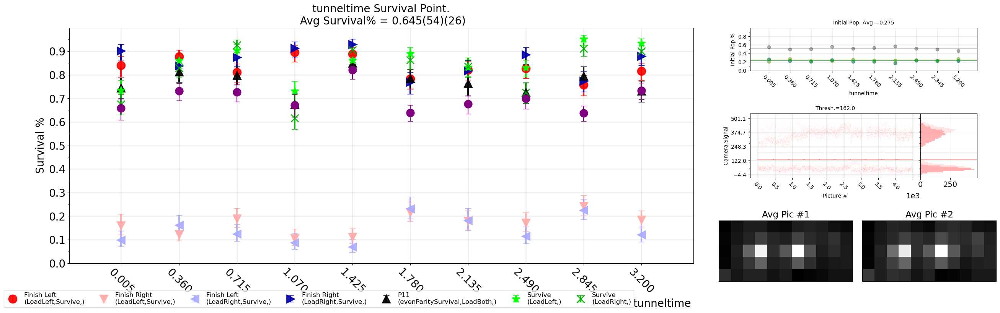

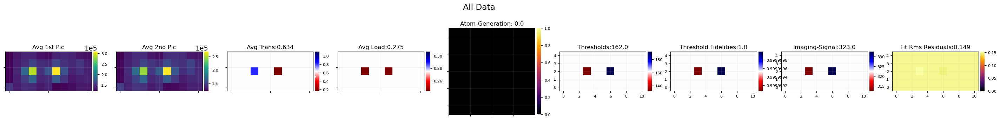

In [32]:
mp.Tunneling(24, [[2,3]],[[2,6]], includeSurvival=True, includeHOM=True);

### File 25 (AdiabaticIntensityInitBiasPerturb): 5ms run again

Number of Pictures: 9000; Picture Dimensions: 5 x 11
Variations: 10;	Repetitions: 450;	Exp File Version: 4;
Experiment started at (H:M:S) 20:18:40: on (Y-M-D) 2021-2-3, And ended at 21:1:50: on 2021-2-3
Experiment Notes: grr not repeatable from nice run earlier...



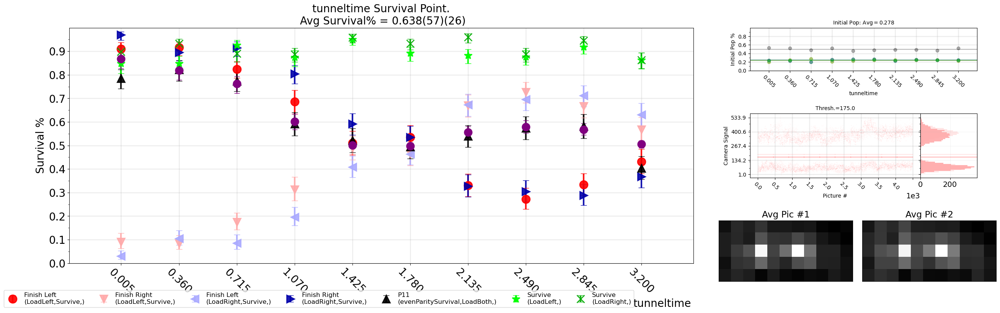

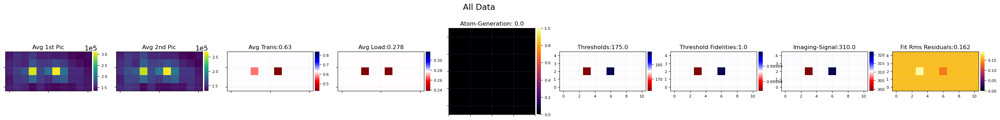

In [33]:
mp.Tunneling(25, [[2,3]],[[2,6]], includeSurvival=True, includeHOM=True);

### File 27 (AdiabaticIntensityInitBiasPerturb): repeat of tunnel time scan at 0.015 depth 5ms ramp

Number of Pictures: 9000; Picture Dimensions: 5 x 11
Variations: 10;	Repetitions: 450;	Exp File Version: 4;
Experiment started at (H:M:S) 21:30:40: on (Y-M-D) 2021-2-3, And ended at 22:13:49: on 2021-2-3
Experiment Notes: yessssss looks like some repeatability even if this isn't quite as good. I'll take it!



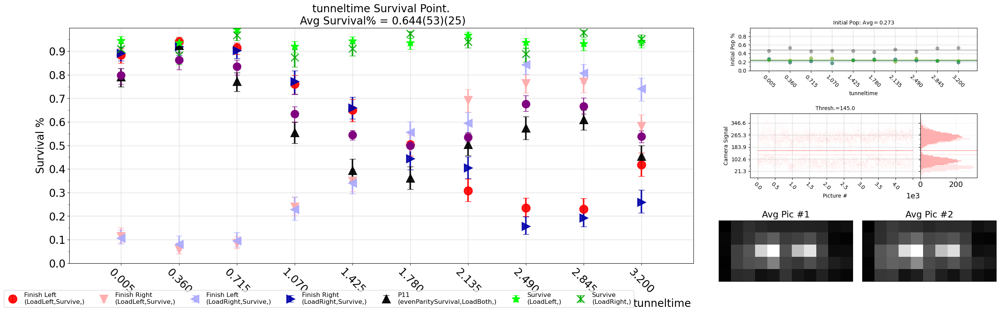

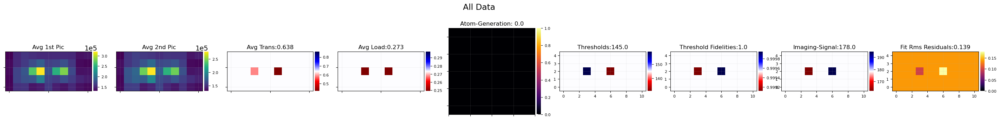

In [35]:
mp.Tunneling(27, [[2,3]],[[2,6]], includeSurvival=True, includeHOM=True);

### File 28 (AdiabaticIntensityInitBiasPerturb): similar at 0.0125 depth

Number of Pictures: 9000; Picture Dimensions: 5 x 11
Variations: 10;	Repetitions: 450;	Exp File Version: 4;
Experiment started at (H:M:S) 22:41:49: on (Y-M-D) 2021-2-3, And ended at 23:25:0: on 2021-2-3
Experiment Notes: WOW! that's fantastic! both the ramsey contrast and the p11 contrast look fantastic here!



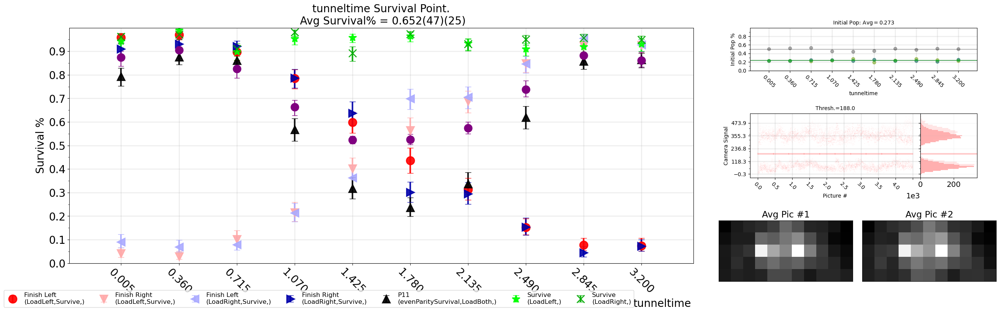

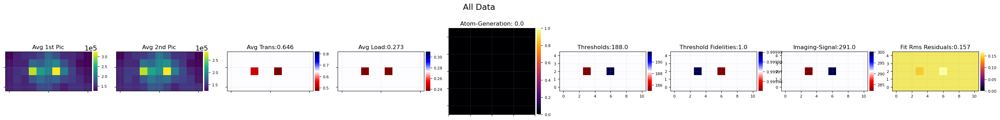

In [36]:
mp.Tunneling(28, [[2,3]],[[2,6]], includeSurvival=True, includeHOM=True);

In [64]:
dr = np.arange(40)
dr = np.delete(dr, [9,12,26, 17])

In [63]:
print(res['Key'],np.argmin(abs(res['Key'] - 8)))

[5.000e-03 1.030e+00 3.695e+00 1.645e+00 6.155e+00 6.360e+00 2.260e+00
 4.310e+00 3.900e+00 2.875e+00 4.720e+00 3.080e+00 5.335e+00 7.590e+00
 6.770e+00 2.670e+00 6.975e+00 8.000e+00 1.440e+00 3.490e+00 6.200e-01
 8.250e-01 7.795e+00 5.950e+00 7.385e+00 4.925e+00 5.540e+00 2.100e-01
 4.105e+00 2.055e+00 6.565e+00 4.515e+00 3.285e+00 5.130e+00 7.180e+00
 1.850e+00 4.150e-01 1.235e+00 5.745e+00 2.465e+00] 17


In [73]:
g1 = [1,20,0.2,-0.271550,0.5]
g2 = [1,20,0.2,2.5,0.5]

In [75]:
reload(decaying_cos)

<module 'Analysis_Python_Files.fitters.decaying_cos' from 'C:\\Users\\Regal-Lab\\Code\\Data-Analysis-Code\\Analysis_Python_Files\\fitters\\decaying_cos.py'>

### File 29 (AdiabaticIntensityInitBiasPerturb): long run overnight 0.0125

Number of Pictures: 64000; Picture Dimensions: 5 x 11
Variations: 40;	Repetitions: 800;	Exp File Version: 4;
Experiment started at (H:M:S) 23:32:15: on (Y-M-D) 2021-2-3, And ended at 4:28:3: on 2021-2-4
Experiment Notes: okay, this is quite good! should continue exploring different tunneling depths I think.



,Amp,Amp-Err,Decay,Decay-Err,Freq,Freq-Err,Phase,Phase-Err,Offset,Offset-Err,Amplitude
fit 0,0.827693,0.034155,6.576959e+02,4.209816e+03,0.188325,0.001580,-0.233004,0.046902,0.511160,0.006985,0.827693
fit 1,0.827693,0.034155,6.576819e+02,4.207251e+03,0.188325,0.001580,2.908589,0.046902,0.488840,0.006985,0.827693
fit 2,0.885516,0.042587,6.382075e+01,4.774543e+01,0.190312,0.001946,2.854438,0.056096,0.487243,0.008601,0.885516
fit 3,0.885516,0.042587,6.382044e+01,4.775114e+01,0.190312,0.001946,-0.287155,0.056096,0.512757,0.008601,0.885516
fit 4,0.574341,0.057687,5.873187e+06,5.454634e+11,0.383634,0.003653,-0.732053,0.106875,0.569158,0.011436,0.574341
fit 5,1.199999,229.800123,1.207452e-01,1.139812e+00,0.201516,36.068457,-1.531031,7.681588,0.923534,0.004533,1.199999
fit 6,1.199806,909.521771,2.882207e+00,1.418855e+01,0.005959,4.477267,-1.524461,34.622690,0.906185,0.326666,1.199806
Mean Val,0.914366,162.790438,8.392333e+05,7.792335e+10,0.192626,5.793776,0.207903,6.088164,0.628411,0.053401,0.914366
Median Val,0.885516,0.050137,3.607513e+02,2.127501e+03,0.190312,0.002800,-0.260080,0.081485,0.540957,0.008601,0.885516
Std Val,0.181386,282.464268,1.831504e+06,1.701056e+11,0.089107,11.134600,1.557794,10.699796,0.163672,0.099404,0.181386


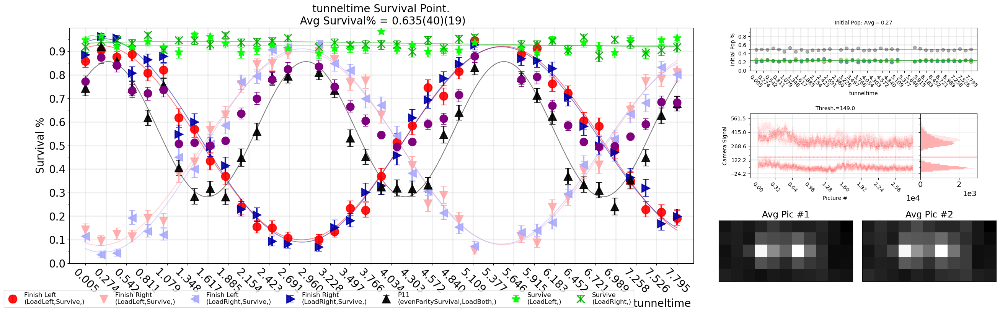

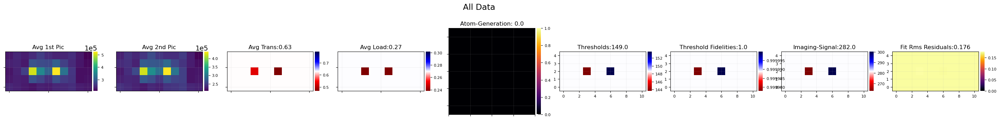

In [76]:
res = mp.Tunneling( 29, [[2,3]],[[2,6]], includeSurvival=True, includeHOM=True, dataRange=dr, fitModules=decaying_cos, 
                    fitguess=[g1,g2,g2,g1,g1,g1,g1,g1]);